In [1]:
library(Seurat)

library(dplyr)
library(glue)
library(ggplot2)
library(patchwork)
library(cowplot)
library(stringr)
library(tidyr)
library("dplyr")

sample_id = c("mWT","mNFIXko")
myList = list()
for(i in 1:length(sample_id)){
    s=sample_id[i]
    dir = glue("{s}/outs/filtered_feature_bc_matrix")
    myData <- Read10X(data.dir = dir)
    myList[[i]]  <- CreateSeuratObject(counts = myData[["Gene Expression"]], min.cells = 0, min.features = 0,project = s, assay = "RNA")
    myList[[i]][["ADT"]] <- CreateAssayObject(myData[["Antibody Capture"]][, colnames(x = myList[[i]] )])

}

Attaching SeuratObject


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘glue’


The following object is masked from ‘package:dplyr’:

    collapse



Attaching package: ‘cowplot’


The following object is masked from ‘package:patchwork’:

    align_plots


10X data contains more than one type and is being returned as a list containing matrices of each type.

Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”
10X data contains more than one type and is being returned as a list containing matrices of each type.

Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”


In [2]:
merged_obj = merge(myList[[1]], y = myList[[2]],add.cell.ids = sample_id)

In [3]:
merged_obj[["percent.mt"]] <- PercentageFeatureSet(merged_obj, pattern = "^mt-")


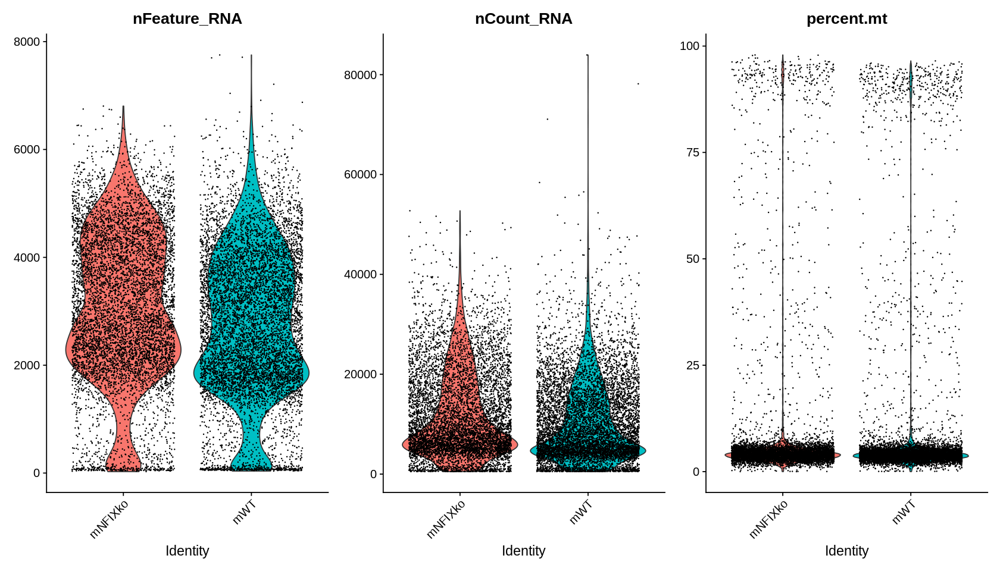

In [7]:
options(repr.plot.width = 14, repr.plot.height = 8)

VlnPlot(merged_obj, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3)


In [8]:
merged_obj <- subset(merged_obj, subset = nFeature_RNA >= 200 & nFeature_RNA <= 6000 & percent.mt <= 10 & nFeature_RNA <=50000)


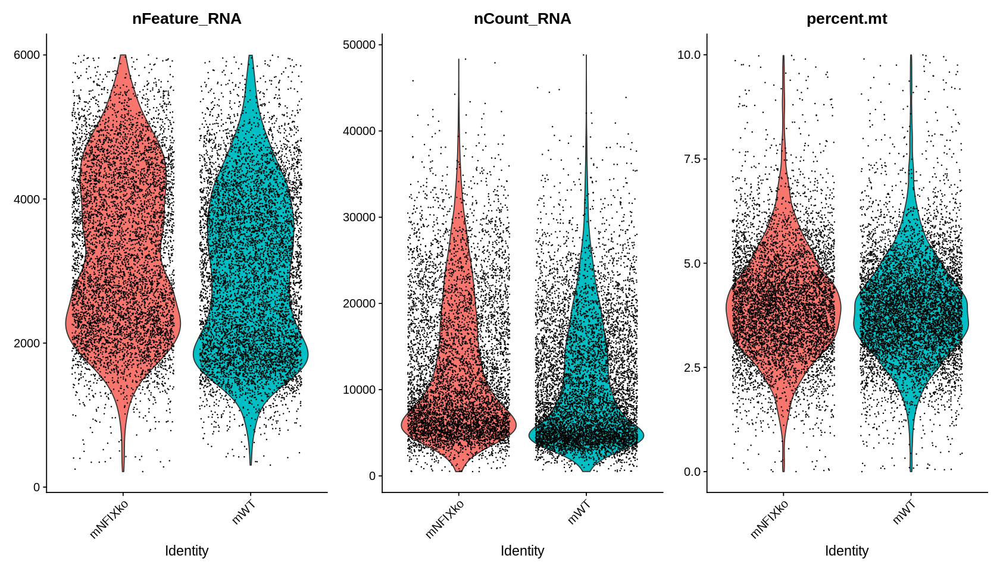

In [9]:
options(repr.plot.width = 14, repr.plot.height = 8)

VlnPlot(merged_obj, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3)


Centering and scaling data matrix

PC_ 1 
Positive:  Ermap, Mns1, Rhd, Klf1, Car1, C1qtnf12, Blvrb, Cldn13, Mt2, Mt1 
	   Glrx5, Tmem14c, Sphk1, Nxpe2, Dut, Hmbs, Aqp1, Cpox, Mki67, Add2 
	   Slc25a21, Hmgb2, Slc38a5, Birc5, Smim1, Rgs10, Cks2, Hdgf, Asns, Rhag 
Negative:  Ifitm1, Tmsb4x, Hlf, Myl10, Angpt1, Coro1a, Ly6a, Gcnt2, Mecom, Ifi203 
	   Gimap1, Ctla2a, Sox4, Adgrl4, Srgn, Hacd4, Arpc1b, Ltb, Cd63, Pkm 
	   Sptbn1, Lyz2, Gimap6, Limd2, Sh3bgrl3, Mef2c, Lsp1, Rbp1, Gng11, Slc18a2 
PC_ 2 
Positive:  Car2, Vamp5, Zfpm1, Fth1, Blvrb, Mllt3, Mrpl52, Car1, Nfia, Abcb4 
	   Aqp1, Ermap, Aplp2, Klf1, Ces2g, Bex4, Tspo2, Hlf, Aldh1a1, Angpt1 
	   Gfi1b, Hacd4, Spire1, Gstm5, Prdx2, Sdsl, Pdzk1ip1, Gimap1, Tspan33, Rhd 
Negative:  Ctsg, Mpo, Elane, Ms4a3, Clec12a, Hp, Anxa3, Atp8b4, Igsf6, Ly6c2 
	   Alas1, Plac8, Prtn3, Prss57, F630028O10Rik, Trem3, Serpinb1a, Slpi, Nkg7, Pgam1 
	   Tyrobp, Cst7, Ap3s1, Sdf2l1, Rab44, Calr, Fcgr3, Cebpe, Pglyrp1, Msrb1 
PC_ 3 
Positive:  Ftl1, Mt1, If

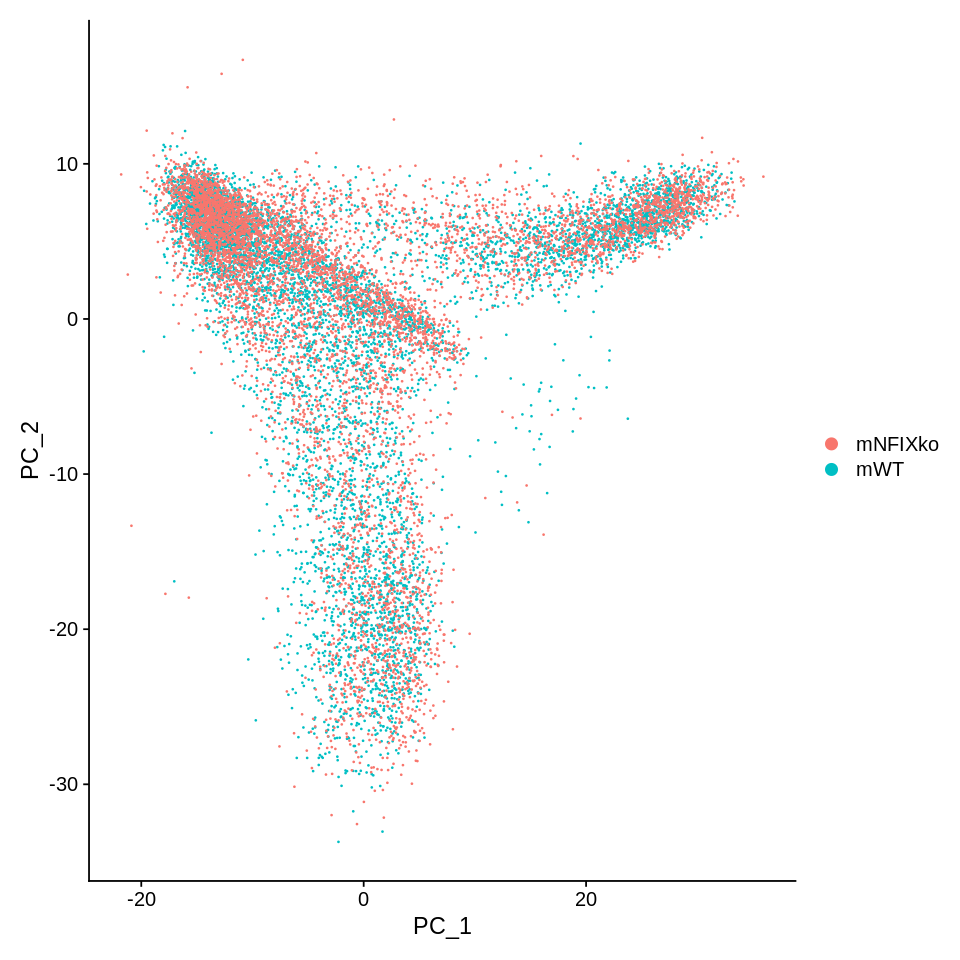

In [10]:
DefaultAssay(merged_obj) <- 'RNA'
merged_obj <- NormalizeData(merged_obj) %>% FindVariableFeatures() %>% ScaleData() %>% RunPCA()
options(repr.plot.width = 8, repr.plot.height = 8)
DimPlot(merged_obj)

Normalizing across cells

Centering and scaling data matrix

Warning message in irlba(A = t(x = object), nv = npcs, ...):
“You're computing too large a percentage of total singular values, use a standard svd instead.”
Warning message:
“Requested number is larger than the number of available items (8). Setting to 8.”
Warning message:
“Requested number is larger than the number of available items (8). Setting to 8.”
Warning message:
“Requested number is larger than the number of available items (8). Setting to 8.”
Warning message:
“Requested number is larger than the number of available items (8). Setting to 8.”
Warning message:
“Requested number is larger than the number of available items (8). Setting to 8.”
PC_ 1 
Positive:  CD48-TotalA, CD16-32-TotalA, CD71-TotalA, CD34-TotalA 
Negative:  CD150-TotalA, CD41-TotalA, Sca1-TotalA, CD105-TotalA 
PC_ 2 
Positive:  CD16-32-TotalA, CD41-TotalA, CD150-TotalA, CD48-TotalA 
Negative:  CD105-TotalA, CD71-TotalA, CD34-TotalA, Sca1-TotalA 
PC_ 3 

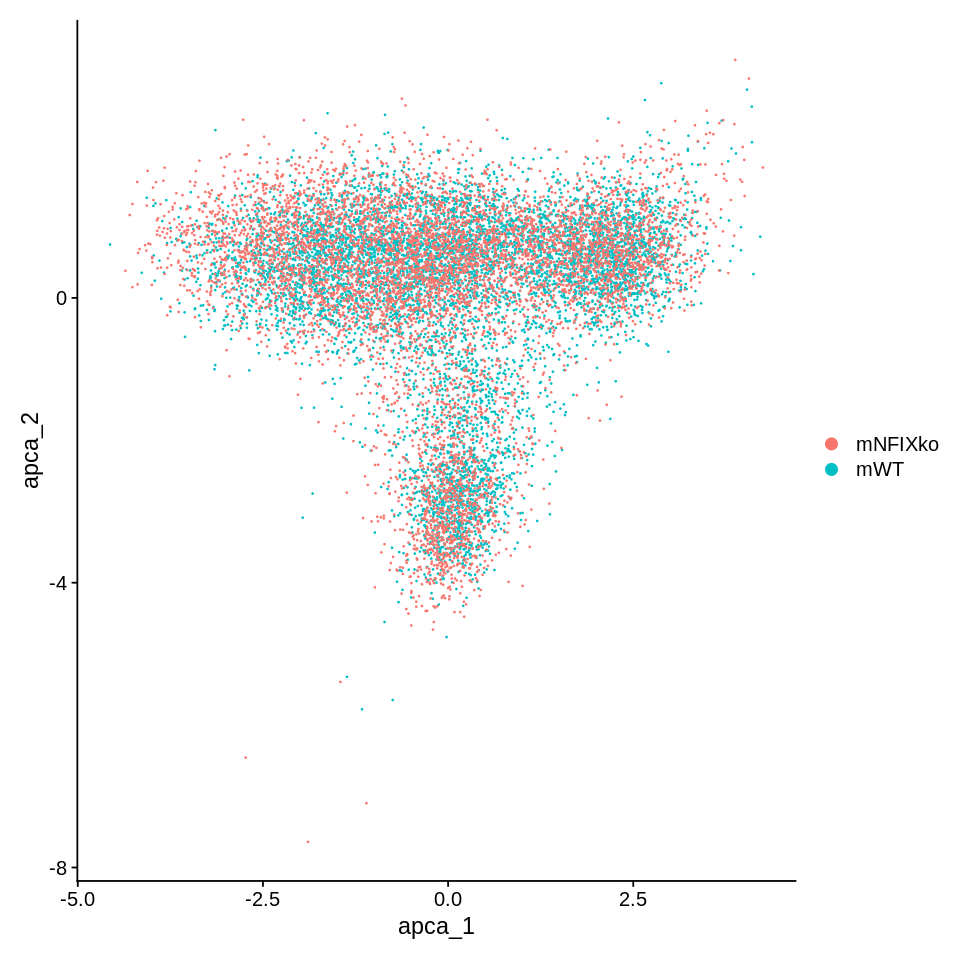

In [11]:
DefaultAssay(merged_obj) <- 'ADT'
VariableFeatures(merged_obj) <- rownames(merged_obj[["ADT"]])
merged_obj <- NormalizeData(merged_obj, normalization.method = 'CLR', margin = 2) %>% 
  ScaleData() %>% RunPCA(reduction.name = 'apca')
DimPlot(merged_obj)

In [12]:
merged_obj <- FindMultiModalNeighbors(
  merged_obj, reduction.list = list("pca", "apca"), 
  dims.list = list(1:50, 1:7), modality.weight.name = "RNA.weight"
)

Calculating cell-specific modality weights

Finding 20 nearest neighbors for each modality.

Calculating kernel bandwidths

Warning message in FindMultiModalNeighbors(merged_obj, reduction.list = list("pca", :
“The number of provided modality.weight.name is not equal to the number of modalities. RNA.weight ADT.weight are used to store the modality weights”
Finding multimodal neighbors

Constructing multimodal KNN graph

Constructing multimodal SNN graph



Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
15:17:01 UMAP embedding parameters a = 0.9922 b = 1.112

15:17:01 Commencing smooth kNN distance calibration using 1 thread

15:17:02 Initializing from normalized Laplacian + noise

15:17:02 Commencing optimization for 200 epochs, with 419414 positive edges

15:17:19 Optimization finished



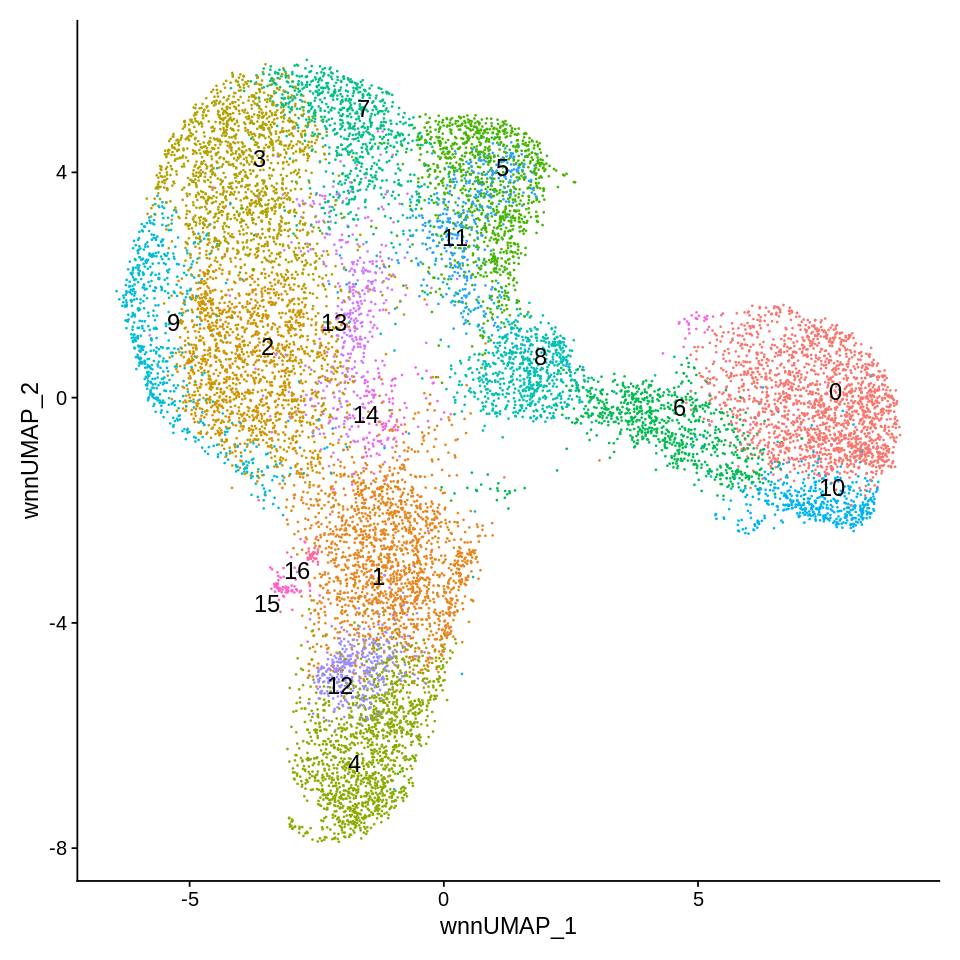

In [13]:
merged_obj <- RunUMAP(merged_obj, nn.name = "weighted.nn", reduction.name = "wnn.umap", reduction.key = "wnnUMAP_")
merged_obj <- FindClusters(merged_obj, graph.name = "wsnn", algorithm = 3, resolution = 1, verbose = FALSE)
DimPlot(merged_obj, reduction = 'wnn.umap', label = TRUE, repel = TRUE, label.size = 5) + NoLegend()


In [442]:
merged_obj <- RunUMAP(merged_obj, reduction = 'pca', dims = 1:50, assay = 'RNA', 
              reduction.name = 'rna.umap', reduction.key = 'rnaUMAP_')
merged_obj <- RunUMAP(merged_obj, reduction = 'apca', dims = 1:7, assay = 'ADT', 
              reduction.name = 'adt.umap', reduction.key = 'adtUMAP_')

11:45:02 UMAP embedding parameters a = 0.9922 b = 1.112

11:45:02 Read 13949 rows and found 50 numeric columns

11:45:02 Using Annoy for neighbor search, n_neighbors = 30

11:45:02 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

11:45:03 Writing NN index file to temp file /tmp/RtmpYARAy7/filead226f464a84

11:45:03 Searching Annoy index using 1 thread, search_k = 3000

11:45:08 Annoy recall = 100%

11:45:09 Commencing smooth kNN distance calibration using 1 thread

11:45:10 Initializing from normalized Laplacian + noise

11:45:11 Commencing optimization for 200 epochs, with 611270 positive edges

11:45:28 Optimization finished

11:45:28 UMAP embedding parameters a = 0.9922 b = 1.112

11:45:28 Read 13949 rows and found 7 numeric columns

11:45:28 Using Annoy for neighbor

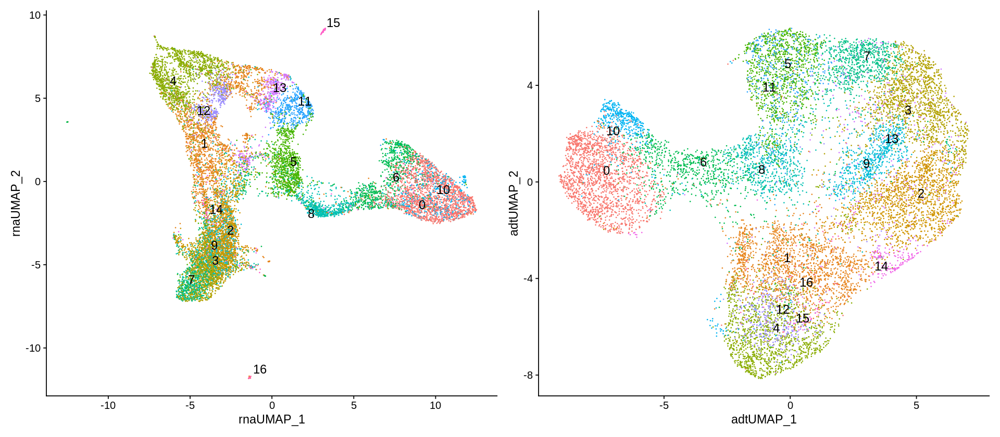

In [444]:
options(repr.plot.width = 16, repr.plot.height = 7)

p3 <- DimPlot(merged_obj, reduction = 'rna.umap', label = TRUE, 
              repel = TRUE, label.size =5) + NoLegend()
p4 <- DimPlot(merged_obj, reduction = 'adt.umap', label = TRUE, 
              repel = TRUE, label.size = 5) + NoLegend()
p3 + p4

In [14]:
library(scCATCH)


In [16]:
save(merged_obj,file="nfix.scRNA.rds")

In [31]:
save(clu_ann_Bone,clu_ann_BM,clu_ann_Blood,file="nfix.scRNA.clusters.rds")

In [29]:
clu_markers_Bone <- findmarkergenes(object = merged_obj,
                               species = 'Mouse',
                               cluster = 'All',
                               match_CellMatch = T,
                               cancer = NULL,
                               tissue = "Bone",
                               cell_min_pct = 0.01,
                               logfc = 0.05,
                               pvalue = 0.5)
clu_ann_Bone <- scCATCH(object = clu_markers_Bone$clu_markers,
                   species = 'Mouse',
                   cancer = NULL,
                   tissue = 'Bone')

Note: the raw data matrix includes 13949 cells and 31053 genes. 

---Revising gene symbols according to NCBI Gene symbols (updated in June 19, 2020, https://www.ncbi.nlm.nih.gov/gene) and no matched genes and duplicated genes will be removed. 

Note: the new data matrix includes 13949 cells and 26989 genes. 

Note: there are 172 potential marker genes in CellMatch database for Mouse on Bone. 
Note: There are 17 clusters in Seurat object. 
Preparing to find potential marker genes for All cluster(s). 
Finding potential marker genes for cluster 0 



[>-----------------------------] Finished:  4% Remaining: 5s

[>-----------------------------] Finished:  5% Remaining: 5s

[+>----------------------------] Finished:  5% Remaining: 5s

[+>----------------------------] Finished:  6% Remaining: 5s

[+>----------------------------] Finished:  7% Remaining: 5s

[+>----------------------------] Finished:  8% Remaining: 5s

[++>---------------------------] Finished:  8% Remaining: 5s

[++>---------------------------] Finished:  9% Remaining: 5s

[++>---------------------------] Finished: 10% Remaining: 5s

[++>---------------------------] Finished: 11% Remaining: 5s

[++>---------------------------] Finished: 12% Remaining: 5s

[+++>--------------------------] Finished: 12% Remaining: 5s

[+++>--------------------------] Finished: 13% Remaining: 5s

[+++>--------------------------] Finished: 14% Remaining: 5s

[+++>--------------------------] Finished: 15% Remaining: 5s

[++++>-------------------------] Finished: 15% Remaining: 5s

[++++>-

---Done--- 
Finding potential marker genes for cluster 1 



[>-----------------------------] Finished:  3% Remaining: 6s

[>-----------------------------] Finished:  4% Remaining: 6s

[>-----------------------------] Finished:  5% Remaining: 6s

[+>----------------------------] Finished:  5% Remaining: 6s

[+>----------------------------] Finished:  6% Remaining: 6s

[+>----------------------------] Finished:  7% Remaining: 6s

[+>----------------------------] Finished:  8% Remaining: 6s

[++>---------------------------] Finished:  8% Remaining: 6s

[++>---------------------------] Finished:  9% Remaining: 6s

[++>---------------------------] Finished: 10% Remaining: 6s

[++>---------------------------] Finished: 11% Remaining: 6s

[++>---------------------------] Finished: 12% Remaining: 6s

[+++>--------------------------] Finished: 12% Remaining: 6s

[+++>--------------------------] Finished: 13% Remaining: 6s

[+++>--------------------------] Finished: 14% Remaining: 6s

[+++>--------------------------] Finished: 15% Remaining: 6s

[++++>-

---Done--- 
Finding potential marker genes for cluster 2 



[>-----------------------------] Finished:  4% Remaining: 5s

[>-----------------------------] Finished:  5% Remaining: 5s

[+>----------------------------] Finished:  5% Remaining: 5s

[+>----------------------------] Finished:  6% Remaining: 5s

[+>----------------------------] Finished:  7% Remaining: 5s

[+>----------------------------] Finished:  8% Remaining: 5s

[++>---------------------------] Finished:  8% Remaining: 5s

[++>---------------------------] Finished:  9% Remaining: 5s

[++>---------------------------] Finished: 10% Remaining: 5s

[++>---------------------------] Finished: 11% Remaining: 5s

[++>---------------------------] Finished: 12% Remaining: 5s

[+++>--------------------------] Finished: 12% Remaining: 5s

[+++>--------------------------] Finished: 13% Remaining: 5s

[+++>--------------------------] Finished: 14% Remaining: 5s

[+++>--------------------------] Finished: 15% Remaining: 5s

[++++>-------------------------] Finished: 15% Remaining: 5s

[++++>-

---Done--- 
Finding potential marker genes for cluster 3 



[>-----------------------------] Finished:  4% Remaining: 5s

[>-----------------------------] Finished:  5% Remaining: 5s

[+>----------------------------] Finished:  5% Remaining: 5s

[+>----------------------------] Finished:  6% Remaining: 5s

[+>----------------------------] Finished:  7% Remaining: 5s

[+>----------------------------] Finished:  8% Remaining: 5s

[++>---------------------------] Finished:  8% Remaining: 5s

[++>---------------------------] Finished:  9% Remaining: 5s

[++>---------------------------] Finished: 10% Remaining: 5s

[++>---------------------------] Finished: 11% Remaining: 5s

[++>---------------------------] Finished: 12% Remaining: 5s

[+++>--------------------------] Finished: 12% Remaining: 5s

[+++>--------------------------] Finished: 13% Remaining: 5s

[+++>--------------------------] Finished: 14% Remaining: 5s

[+++>--------------------------] Finished: 15% Remaining: 5s

[++++>-------------------------] Finished: 15% Remaining: 5s

[++++>-

---Done--- 
Finding potential marker genes for cluster 4 



[>-----------------------------] Finished:  4% Remaining: 5s

[>-----------------------------] Finished:  5% Remaining: 5s

[>-----------------------------] Finished:  5% Remaining: 6s

[>-----------------------------] Finished:  5% Remaining: 5s

[>-----------------------------] Finished:  5% Remaining: 6s

[+>----------------------------] Finished:  5% Remaining: 6s

[+>----------------------------] Finished:  6% Remaining: 6s

[+>----------------------------] Finished:  7% Remaining: 6s

[+>----------------------------] Finished:  7% Remaining: 5s

[+>----------------------------] Finished:  7% Remaining: 6s

[+>----------------------------] Finished:  8% Remaining: 6s

[++>---------------------------] Finished:  8% Remaining: 6s

[++>---------------------------] Finished:  9% Remaining: 6s

[++>---------------------------] Finished:  9% Remaining: 5s

[++>---------------------------] Finished: 10% Remaining: 5s

[++>---------------------------] Finished: 10% Remaining: 6s

[++>---

---Done--- 
Finding potential marker genes for cluster 5 



[>-----------------------------] Finished:  5% Remaining: 4s

[+>----------------------------] Finished:  5% Remaining: 4s

[+>----------------------------] Finished:  6% Remaining: 4s

[+>----------------------------] Finished:  6% Remaining: 5s

[+>----------------------------] Finished:  7% Remaining: 5s

[+>----------------------------] Finished:  8% Remaining: 5s

[++>---------------------------] Finished:  8% Remaining: 5s

[++>---------------------------] Finished:  9% Remaining: 5s

[++>---------------------------] Finished:  9% Remaining: 4s

[++>---------------------------] Finished:  9% Remaining: 5s

[++>---------------------------] Finished: 10% Remaining: 5s

[++>---------------------------] Finished: 11% Remaining: 5s

[++>---------------------------] Finished: 12% Remaining: 5s

[+++>--------------------------] Finished: 12% Remaining: 5s

[+++>--------------------------] Finished: 13% Remaining: 5s

[+++>--------------------------] Finished: 14% Remaining: 5s

[+++>--

---Done--- 
Finding potential marker genes for cluster 6 



[+>----------------------------] Finished:  6% Remaining: 3s

[+>----------------------------] Finished:  6% Remaining: 4s

[+>----------------------------] Finished:  6% Remaining: 3s

[+>----------------------------] Finished:  7% Remaining: 4s

[+>----------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  9% Remaining: 4s

[++>---------------------------] Finished:  9% Remaining: 3s

[++>---------------------------] Finished:  9% Remaining: 4s

[++>---------------------------] Finished: 10% Remaining: 4s

[++>---------------------------] Finished: 11% Remaining: 4s

[++>---------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 13% Remaining: 4s

[+++>--------------------------] Finished: 14% Remaining: 4s

[+++>--------------------------] Finished: 15% Remaining: 3s

[+++>--

---Done--- 
Finding potential marker genes for cluster 7 



[+>----------------------------] Finished:  5% Remaining: 4s

[+>----------------------------] Finished:  6% Remaining: 4s

[+>----------------------------] Finished:  7% Remaining: 4s

[+>----------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  9% Remaining: 4s

[++>---------------------------] Finished: 10% Remaining: 4s

[++>---------------------------] Finished: 11% Remaining: 4s

[++>---------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 13% Remaining: 4s

[+++>--------------------------] Finished: 14% Remaining: 4s

[+++>--------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 16% Remaining: 4s

[++++>-------------------------] Finished: 17% Remaining: 4s

[++++>-

---Done--- 
Finding potential marker genes for cluster 8 



[+>----------------------------] Finished:  6% Remaining: 3s

[+>----------------------------] Finished:  6% Remaining: 4s

[+>----------------------------] Finished:  6% Remaining: 3s

[+>----------------------------] Finished:  7% Remaining: 4s

[+>----------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  9% Remaining: 4s

[++>---------------------------] Finished: 10% Remaining: 4s

[++>---------------------------] Finished: 11% Remaining: 4s

[++>---------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 13% Remaining: 4s

[+++>--------------------------] Finished: 14% Remaining: 4s

[+++>--------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 15% Remaining: 3s

[++++>-

---Done--- 
Finding potential marker genes for cluster 9 



[+>----------------------------] Finished:  5% Remaining: 4s

[+>----------------------------] Finished:  6% Remaining: 4s

[+>----------------------------] Finished:  7% Remaining: 4s

[+>----------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  9% Remaining: 4s

[++>---------------------------] Finished: 10% Remaining: 4s

[++>---------------------------] Finished: 11% Remaining: 4s

[++>---------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 13% Remaining: 4s

[+++>--------------------------] Finished: 14% Remaining: 4s

[+++>--------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 16% Remaining: 4s

[++++>-------------------------] Finished: 17% Remaining: 4s

[++++>-

---Done--- 
Finding potential marker genes for cluster 10 



[+>----------------------------] Finished:  6% Remaining: 3s

[+>----------------------------] Finished:  6% Remaining: 4s

[+>----------------------------] Finished:  7% Remaining: 4s

[+>----------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  9% Remaining: 4s

[++>---------------------------] Finished: 10% Remaining: 4s

[++>---------------------------] Finished: 11% Remaining: 4s

[++>---------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 13% Remaining: 4s

[+++>--------------------------] Finished: 14% Remaining: 4s

[+++>--------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 16% Remaining: 4s

[++++>-------------------------] Finished: 17% Remaining: 4s

[++++>-

---Done--- 
Finding potential marker genes for cluster 11 



[>-----------------------------] Finished:  4% Remaining: 5s

[>-----------------------------] Finished:  5% Remaining: 5s

[+>----------------------------] Finished:  5% Remaining: 5s

[+>----------------------------] Finished:  6% Remaining: 5s

[+>----------------------------] Finished:  7% Remaining: 5s

[+>----------------------------] Finished:  8% Remaining: 5s

[+>----------------------------] Finished:  8% Remaining: 4s

[+>----------------------------] Finished:  8% Remaining: 5s

[+>----------------------------] Finished:  8% Remaining: 4s

[+>----------------------------] Finished:  8% Remaining: 5s

[++>---------------------------] Finished:  8% Remaining: 5s

[++>---------------------------] Finished:  9% Remaining: 5s

[++>---------------------------] Finished:  9% Remaining: 4s

[++>---------------------------] Finished: 10% Remaining: 4s

[++>---------------------------] Finished: 11% Remaining: 4s

[++>---------------------------] Finished: 12% Remaining: 4s

[+++>--

---Done--- 
Finding potential marker genes for cluster 12 



[+>----------------------------] Finished:  5% Remaining: 4s

[+>----------------------------] Finished:  6% Remaining: 4s

[+>----------------------------] Finished:  7% Remaining: 4s

[+>----------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  9% Remaining: 4s

[++>---------------------------] Finished: 10% Remaining: 4s

[++>---------------------------] Finished: 11% Remaining: 4s

[++>---------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 13% Remaining: 4s

[+++>--------------------------] Finished: 14% Remaining: 4s

[+++>--------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 16% Remaining: 4s

[++++>-------------------------] Finished: 17% Remaining: 4s

[++++>-

---Done--- 
Finding potential marker genes for cluster 13 



[+>----------------------------] Finished:  6% Remaining: 3s

[+>----------------------------] Finished:  6% Remaining: 4s

[+>----------------------------] Finished:  7% Remaining: 4s

[+>----------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  9% Remaining: 4s

[++>---------------------------] Finished: 10% Remaining: 4s

[++>---------------------------] Finished: 11% Remaining: 4s

[++>---------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 13% Remaining: 4s

[+++>--------------------------] Finished: 14% Remaining: 4s

[+++>--------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 16% Remaining: 4s

[++++>-------------------------] Finished: 17% Remaining: 4s

[++++>-

---Done--- 
Finding potential marker genes for cluster 14 



[+>----------------------------] Finished:  6% Remaining: 3s

[+>----------------------------] Finished:  7% Remaining: 3s

[+>----------------------------] Finished:  8% Remaining: 3s

[++>---------------------------] Finished:  8% Remaining: 3s

[++>---------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  9% Remaining: 4s

[++>---------------------------] Finished:  9% Remaining: 3s

[++>---------------------------] Finished:  9% Remaining: 4s

[++>---------------------------] Finished: 10% Remaining: 4s

[++>---------------------------] Finished: 11% Remaining: 4s

[++>---------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 13% Remaining: 4s

[+++>--------------------------] Finished: 14% Remaining: 4s

[+++>--------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 15% Remaining: 4s

[++++>-

---Done--- 
Finding potential marker genes for cluster 15 



[+>----------------------------] Finished:  6% Remaining: 3s

[+>----------------------------] Finished:  6% Remaining: 4s

[+>----------------------------] Finished:  7% Remaining: 4s

[+>----------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  8% Remaining: 4s

[++>---------------------------] Finished:  9% Remaining: 4s

[++>---------------------------] Finished: 10% Remaining: 4s

[++>---------------------------] Finished: 11% Remaining: 4s

[++>---------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 12% Remaining: 4s

[+++>--------------------------] Finished: 13% Remaining: 4s

[+++>--------------------------] Finished: 14% Remaining: 4s

[+++>--------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 15% Remaining: 4s

[++++>-------------------------] Finished: 16% Remaining: 4s

[++++>-------------------------] Finished: 16% Remaining: 3s

[++++>-

---Done--- 
Finding potential marker genes for cluster 16 



[+>----------------------------] Finished:  8% Remaining: 2s

[++>---------------------------] Finished:  8% Remaining: 2s

[++>---------------------------] Finished:  9% Remaining: 2s

[++>---------------------------] Finished: 10% Remaining: 2s

[++>---------------------------] Finished: 11% Remaining: 2s

[++>---------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 12% Remaining: 3s

[+++>--------------------------] Finished: 13% Remaining: 3s

[+++>--------------------------] Finished: 14% Remaining: 3s

[+++>--------------------------] Finished: 15% Remaining: 3s

[++++>-------------------------] Finished: 15% Remaining: 3s

[++++>-------------------------] Finished: 16% Remaining: 3s

[++++>-------------------------] Finished: 17% Remaining: 3s

[++++>-------------------------] Finished: 18% Remaining: 3s

[+++++>------------------------] Finished: 18% Remaining: 3s

[+++++>

---Done--- 
Note: there are 172 potential marker genes in CellMatch database for Mouse on Bone! 
Note: there are 18 cell types in CellMatch database for Mouse on Bone! 
Beginning evidence-based scoring and annotation 



[+++++++>----------------------] Finished: 25% Remaining: 3s

[++++++++++>-------------------] Finished: 38% Remaining: 3s

[++++++++++++++>---------------] Finished: 50% Remaining: 3s

[++++++++++++++++++>-----------] Finished: 62% Remaining: 2s

[+++++++++++++++++++++>--------] Finished: 75% Remaining: 2s

[+++++++++++++++++++++++++>----] Finished: 88% Remaining: 1s

[++++++++++++++++++++++++++++++] Finished:100% Remaining: 0s




---Done--- 


In [25]:
clu_markers_Blood <- findmarkergenes(object = merged_obj,
                               species = 'Mouse',
                               cluster = 'All',
                               match_CellMatch = T,
                               cancer = NULL,
                               tissue = "Blood",
                               cell_min_pct = 0.05,
                               logfc = 0.05,
                               pvalue = 0.5)
clu_ann_Blood <- scCATCH(object = clu_markers_Blood$clu_markers,
                   species = 'Mouse',
                   cancer = NULL,
                   tissue = 'Blood')

Note: the raw data matrix includes 13949 cells and 31053 genes. 

---Revising gene symbols according to NCBI Gene symbols (updated in June 19, 2020, https://www.ncbi.nlm.nih.gov/gene) and no matched genes and duplicated genes will be removed. 

Note: the new data matrix includes 13949 cells and 26989 genes. 

Note: there are 130 potential marker genes in CellMatch database for Mouse on Blood. 
Note: There are 17 clusters in Seurat object. 
Preparing to find potential marker genes for All cluster(s). 
Finding potential marker genes for cluster 0 



[+++>--------------------------] Finished: 14% Remaining: 1s

[+++>--------------------------] Finished: 15% Remaining: 1s

[++++>-------------------------] Finished: 15% Remaining: 1s

[++++>-------------------------] Finished: 16% Remaining: 1s

[++++>-------------------------] Finished: 17% Remaining: 1s

[++++>-------------------------] Finished: 18% Remaining: 1s

[+++++>------------------------] Finished: 18% Remaining: 1s

[+++++>------------------------] Finished: 19% Remaining: 1s

[+++++>------------------------] Finished: 20% Remaining: 1s

[+++++>------------------------] Finished: 21% Remaining: 1s

[+++++>------------------------] Finished: 22% Remaining: 1s

[++++++>-----------------------] Finished: 22% Remaining: 1s

[++++++>-----------------------] Finished: 23% Remaining: 1s

[++++++>-----------------------] Finished: 24% Remaining: 1s

[++++++>-----------------------] Finished: 25% Remaining: 1s

[+++++++>----------------------] Finished: 25% Remaining: 1s

[++++++

---Done--- 
Finding potential marker genes for cluster 1 



[+>----------------------------] Finished:  8% Remaining: 2s

[++>---------------------------] Finished:  8% Remaining: 2s

[++>---------------------------] Finished:  9% Remaining: 2s

[++>---------------------------] Finished: 10% Remaining: 2s

[++>---------------------------] Finished: 11% Remaining: 2s

[++>---------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 13% Remaining: 2s

[+++>--------------------------] Finished: 14% Remaining: 2s

[+++>--------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 16% Remaining: 2s

[++++>-------------------------] Finished: 17% Remaining: 2s

[++++>-------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 19% Remaining: 2s

[+++++>

---Done--- 
Finding potential marker genes for cluster 2 



[++>---------------------------] Finished:  9% Remaining: 2s

[++>---------------------------] Finished: 10% Remaining: 2s

[++>---------------------------] Finished: 10% Remaining: 3s

[++>---------------------------] Finished: 10% Remaining: 2s

[++>---------------------------] Finished: 11% Remaining: 2s

[++>---------------------------] Finished: 11% Remaining: 3s

[++>---------------------------] Finished: 12% Remaining: 3s

[+++>--------------------------] Finished: 12% Remaining: 3s

[+++>--------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 12% Remaining: 3s

[+++>--------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 13% Remaining: 3s

[+++>--------------------------] Finished: 14% Remaining: 3s

[+++>--------------------------] Finished: 14% Remaining: 2s

[+++>--------------------------] Finished: 15% Remaining: 3s

[+++>--------------------------] Finished: 15% Remaining: 2s

[++++>-

---Done--- 
Finding potential marker genes for cluster 3 



[++>---------------------------] Finished:  9% Remaining: 2s

[++>---------------------------] Finished: 10% Remaining: 2s

[++>---------------------------] Finished: 11% Remaining: 2s

[++>---------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 13% Remaining: 2s

[+++>--------------------------] Finished: 14% Remaining: 2s

[+++>--------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 16% Remaining: 2s

[++++>-------------------------] Finished: 17% Remaining: 2s

[++++>-------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 19% Remaining: 2s

[+++++>------------------------] Finished: 20% Remaining: 2s

[+++++>------------------------] Finished: 21% Remaining: 2s

[+++++>

---Done--- 
Finding potential marker genes for cluster 4 



[+>----------------------------] Finished:  6% Remaining: 3s

[+>----------------------------] Finished:  7% Remaining: 3s

[+>----------------------------] Finished:  8% Remaining: 3s

[++>---------------------------] Finished:  8% Remaining: 3s

[++>---------------------------] Finished:  9% Remaining: 3s

[++>---------------------------] Finished: 10% Remaining: 3s

[++>---------------------------] Finished: 11% Remaining: 3s

[++>---------------------------] Finished: 12% Remaining: 3s

[+++>--------------------------] Finished: 12% Remaining: 3s

[+++>--------------------------] Finished: 13% Remaining: 3s

[+++>--------------------------] Finished: 14% Remaining: 3s

[+++>--------------------------] Finished: 15% Remaining: 3s

[++++>-------------------------] Finished: 15% Remaining: 3s

[++++>-------------------------] Finished: 16% Remaining: 3s

[++++>-------------------------] Finished: 17% Remaining: 3s

[++++>-------------------------] Finished: 18% Remaining: 3s

[++++>-

---Done--- 
Finding potential marker genes for cluster 5 



[++>---------------------------] Finished: 10% Remaining: 2s

[++>---------------------------] Finished: 11% Remaining: 2s

[++>---------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 13% Remaining: 2s

[+++>--------------------------] Finished: 14% Remaining: 2s

[+++>--------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 16% Remaining: 2s

[++++>-------------------------] Finished: 17% Remaining: 2s

[++++>-------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 19% Remaining: 2s

[+++++>------------------------] Finished: 20% Remaining: 2s

[+++++>------------------------] Finished: 21% Remaining: 2s

[+++++>------------------------] Finished: 22% Remaining: 2s

[++++++

---Done--- 
Finding potential marker genes for cluster 6 



[+++>--------------------------] Finished: 12% Remaining: 1s

[+++>--------------------------] Finished: 13% Remaining: 1s

[+++>--------------------------] Finished: 13% Remaining: 2s

[+++>--------------------------] Finished: 14% Remaining: 2s

[+++>--------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 16% Remaining: 2s

[++++>-------------------------] Finished: 17% Remaining: 2s

[++++>-------------------------] Finished: 18% Remaining: 2s

[++++>-------------------------] Finished: 18% Remaining: 1s

[++++>-------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 19% Remaining: 2s

[+++++>------------------------] Finished: 20% Remaining: 2s

[+++++>------------------------] Finished: 21% Remaining: 2s

[+++++>------------------------] Finished: 21% Remaining: 1s

[+++++>

---Done--- 
Finding potential marker genes for cluster 7 



[+++>--------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 12% Remaining: 1s

[+++>--------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 13% Remaining: 2s

[+++>--------------------------] Finished: 14% Remaining: 2s

[+++>--------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 16% Remaining: 2s

[++++>-------------------------] Finished: 17% Remaining: 2s

[++++>-------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 19% Remaining: 2s

[+++++>------------------------] Finished: 20% Remaining: 2s

[+++++>------------------------] Finished: 21% Remaining: 2s

[+++++>------------------------] Finished: 22% Remaining: 2s

[++++++>-----------------------] Finished: 22% Remaining: 2s

[++++++

---Done--- 
Finding potential marker genes for cluster 8 



[+++>--------------------------] Finished: 13% Remaining: 1s

[+++>--------------------------] Finished: 14% Remaining: 1s

[+++>--------------------------] Finished: 15% Remaining: 1s

[++++>-------------------------] Finished: 15% Remaining: 1s

[++++>-------------------------] Finished: 16% Remaining: 1s

[++++>-------------------------] Finished: 17% Remaining: 1s

[++++>-------------------------] Finished: 18% Remaining: 1s

[+++++>------------------------] Finished: 18% Remaining: 1s

[+++++>------------------------] Finished: 19% Remaining: 1s

[+++++>------------------------] Finished: 20% Remaining: 1s

[+++++>------------------------] Finished: 21% Remaining: 1s

[+++++>------------------------] Finished: 22% Remaining: 1s

[++++++>-----------------------] Finished: 22% Remaining: 1s

[++++++>-----------------------] Finished: 23% Remaining: 1s

[++++++>-----------------------] Finished: 24% Remaining: 1s

[++++++>-----------------------] Finished: 25% Remaining: 1s

[++++++

---Done--- 
Finding potential marker genes for cluster 9 



[+++>--------------------------] Finished: 12% Remaining: 1s

[+++>--------------------------] Finished: 13% Remaining: 2s

[+++>--------------------------] Finished: 14% Remaining: 2s

[+++>--------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 16% Remaining: 2s

[++++>-------------------------] Finished: 17% Remaining: 2s

[++++>-------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 19% Remaining: 2s

[+++++>------------------------] Finished: 20% Remaining: 2s

[+++++>------------------------] Finished: 21% Remaining: 2s

[+++++>------------------------] Finished: 22% Remaining: 2s

[++++++>-----------------------] Finished: 22% Remaining: 2s

[++++++>-----------------------] Finished: 23% Remaining: 2s

[++++++>-----------------------] Finished: 24% Remaining: 2s

[++++++

---Done--- 
Finding potential marker genes for cluster 10 



[+++>--------------------------] Finished: 13% Remaining: 1s

[+++>--------------------------] Finished: 14% Remaining: 1s

[+++>--------------------------] Finished: 15% Remaining: 1s

[++++>-------------------------] Finished: 15% Remaining: 1s

[++++>-------------------------] Finished: 16% Remaining: 1s

[++++>-------------------------] Finished: 17% Remaining: 1s

[++++>-------------------------] Finished: 18% Remaining: 1s

[+++++>------------------------] Finished: 18% Remaining: 1s

[+++++>------------------------] Finished: 19% Remaining: 1s

[+++++>------------------------] Finished: 20% Remaining: 1s

[+++++>------------------------] Finished: 21% Remaining: 1s

[+++++>------------------------] Finished: 22% Remaining: 1s

[++++++>-----------------------] Finished: 22% Remaining: 1s

[++++++>-----------------------] Finished: 23% Remaining: 1s

[++++++>-----------------------] Finished: 24% Remaining: 1s

[++++++>-----------------------] Finished: 25% Remaining: 1s

[++++++

---Done--- 
Finding potential marker genes for cluster 11 



[++>---------------------------] Finished: 11% Remaining: 2s

[++>---------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 13% Remaining: 2s

[+++>--------------------------] Finished: 14% Remaining: 2s

[+++>--------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 16% Remaining: 2s

[++++>-------------------------] Finished: 17% Remaining: 2s

[++++>-------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 19% Remaining: 2s

[+++++>------------------------] Finished: 20% Remaining: 2s

[+++++>------------------------] Finished: 21% Remaining: 2s

[+++++>------------------------] Finished: 22% Remaining: 2s

[++++++>-----------------------] Finished: 22% Remaining: 2s

[++++++

---Done--- 
Finding potential marker genes for cluster 12 



[+++>--------------------------] Finished: 12% Remaining: 1s

[+++>--------------------------] Finished: 13% Remaining: 1s

[+++>--------------------------] Finished: 13% Remaining: 2s

[+++>--------------------------] Finished: 14% Remaining: 2s

[+++>--------------------------] Finished: 14% Remaining: 1s

[+++>--------------------------] Finished: 14% Remaining: 2s

[+++>--------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 16% Remaining: 2s

[++++>-------------------------] Finished: 17% Remaining: 2s

[++++>-------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 19% Remaining: 2s

[+++++>------------------------] Finished: 20% Remaining: 2s

[+++++>------------------------] Finished: 21% Remaining: 2s

[+++++>------------------------] Finished: 21% Remaining: 1s

[+++++>

---Done--- 
Finding potential marker genes for cluster 13 



[++>---------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 13% Remaining: 2s

[+++>--------------------------] Finished: 14% Remaining: 2s

[+++>--------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 16% Remaining: 2s

[++++>-------------------------] Finished: 17% Remaining: 2s

[++++>-------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 19% Remaining: 2s

[+++++>------------------------] Finished: 20% Remaining: 2s

[+++++>------------------------] Finished: 21% Remaining: 2s

[+++++>------------------------] Finished: 22% Remaining: 2s

[++++++>-----------------------] Finished: 22% Remaining: 2s

[++++++>-----------------------] Finished: 23% Remaining: 2s

[++++++

---Done--- 
Finding potential marker genes for cluster 14 



[++>---------------------------] Finished: 11% Remaining: 2s

[++>---------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 13% Remaining: 2s

[+++>--------------------------] Finished: 14% Remaining: 2s

[+++>--------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 16% Remaining: 2s

[++++>-------------------------] Finished: 17% Remaining: 2s

[++++>-------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 19% Remaining: 2s

[+++++>------------------------] Finished: 20% Remaining: 2s

[+++++>------------------------] Finished: 21% Remaining: 2s

[+++++>------------------------] Finished: 22% Remaining: 2s

[++++++>-----------------------] Finished: 22% Remaining: 2s

[++++++

---Done--- 
Finding potential marker genes for cluster 15 



[+++>--------------------------] Finished: 14% Remaining: 1s

[+++>--------------------------] Finished: 15% Remaining: 1s

[++++>-------------------------] Finished: 15% Remaining: 1s

[++++>-------------------------] Finished: 16% Remaining: 1s

[++++>-------------------------] Finished: 17% Remaining: 1s

[++++>-------------------------] Finished: 18% Remaining: 1s

[+++++>------------------------] Finished: 18% Remaining: 1s

[+++++>------------------------] Finished: 19% Remaining: 1s

[+++++>------------------------] Finished: 20% Remaining: 1s

[+++++>------------------------] Finished: 21% Remaining: 1s

[+++++>------------------------] Finished: 22% Remaining: 1s

[++++++>-----------------------] Finished: 22% Remaining: 1s

[++++++>-----------------------] Finished: 23% Remaining: 1s

[++++++>-----------------------] Finished: 24% Remaining: 1s

[++++++>-----------------------] Finished: 25% Remaining: 1s

[+++++++>----------------------] Finished: 25% Remaining: 1s

[++++++

---Done--- 
Finding potential marker genes for cluster 16 



[++>---------------------------] Finished: 11% Remaining: 2s

[++>---------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 12% Remaining: 2s

[+++>--------------------------] Finished: 13% Remaining: 2s

[+++>--------------------------] Finished: 14% Remaining: 2s

[+++>--------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 15% Remaining: 2s

[++++>-------------------------] Finished: 16% Remaining: 2s

[++++>-------------------------] Finished: 17% Remaining: 2s

[++++>-------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 18% Remaining: 2s

[+++++>------------------------] Finished: 19% Remaining: 2s

[+++++>------------------------] Finished: 20% Remaining: 2s

[+++++>------------------------] Finished: 21% Remaining: 2s

[+++++>------------------------] Finished: 22% Remaining: 2s

[++++++>-----------------------] Finished: 22% Remaining: 2s

[++++++

---Done--- 
Note: there are 130 potential marker genes in CellMatch database for Mouse on Blood! 
Note: there are 34 cell types in CellMatch database for Mouse on Blood! 
Beginning evidence-based scoring and annotation 



[++++++++++++++>---------------] Finished: 50% Remaining: 1s

[+++++++++++++++++++++>--------] Finished: 75% Remaining: 1s

[++++++++++++++++++++++++++++++] Finished:100% Remaining: 0s




---Done--- 


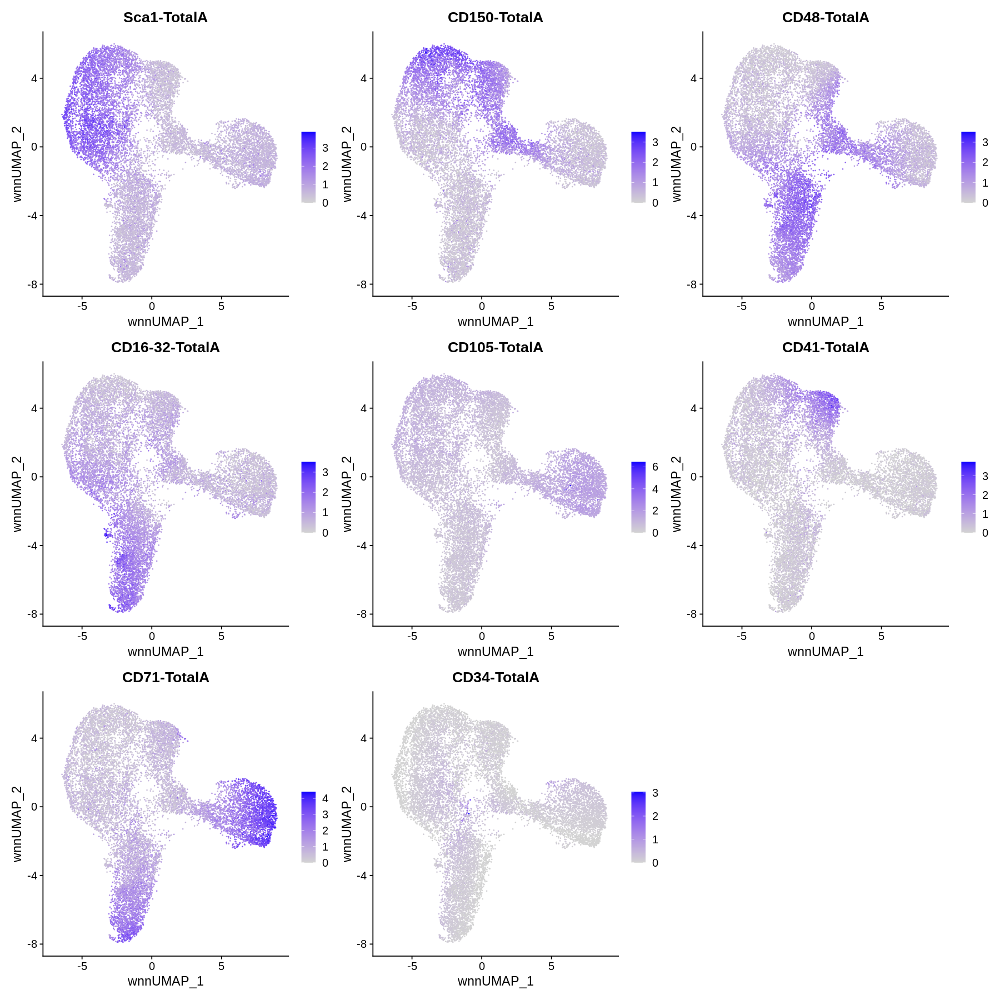

In [32]:
options(repr.plot.width = 15, repr.plot.height = 15)
FeaturePlot(merged_obj, features = rownames(merged_obj@assays$ADT@meta.features), reduction = 'wnn.umap')

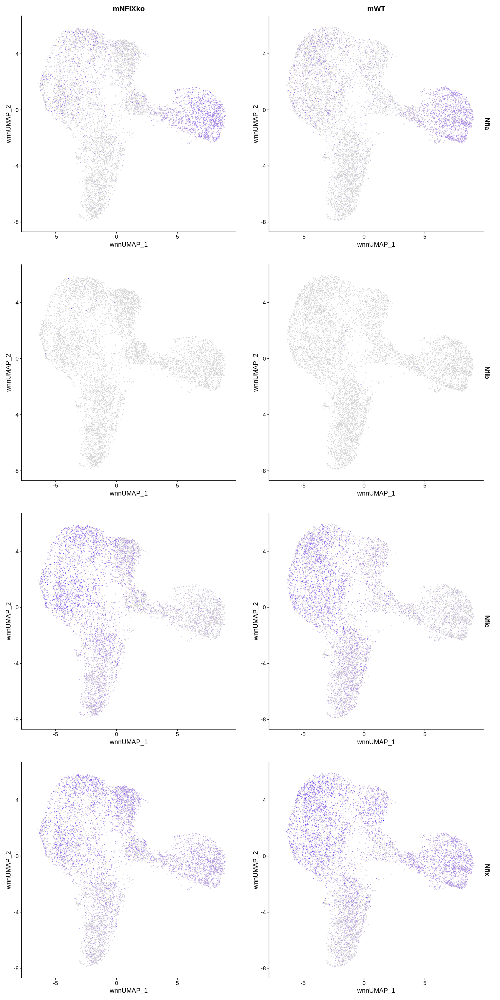

In [450]:
options(repr.plot.width = 15, repr.plot.height = 30)
FeaturePlot(merged_obj, features = c("Nfia","Nfib","Nfic","Nfix"), reduction = 'wnn.umap',ncol =4,split.by="orig.ident")

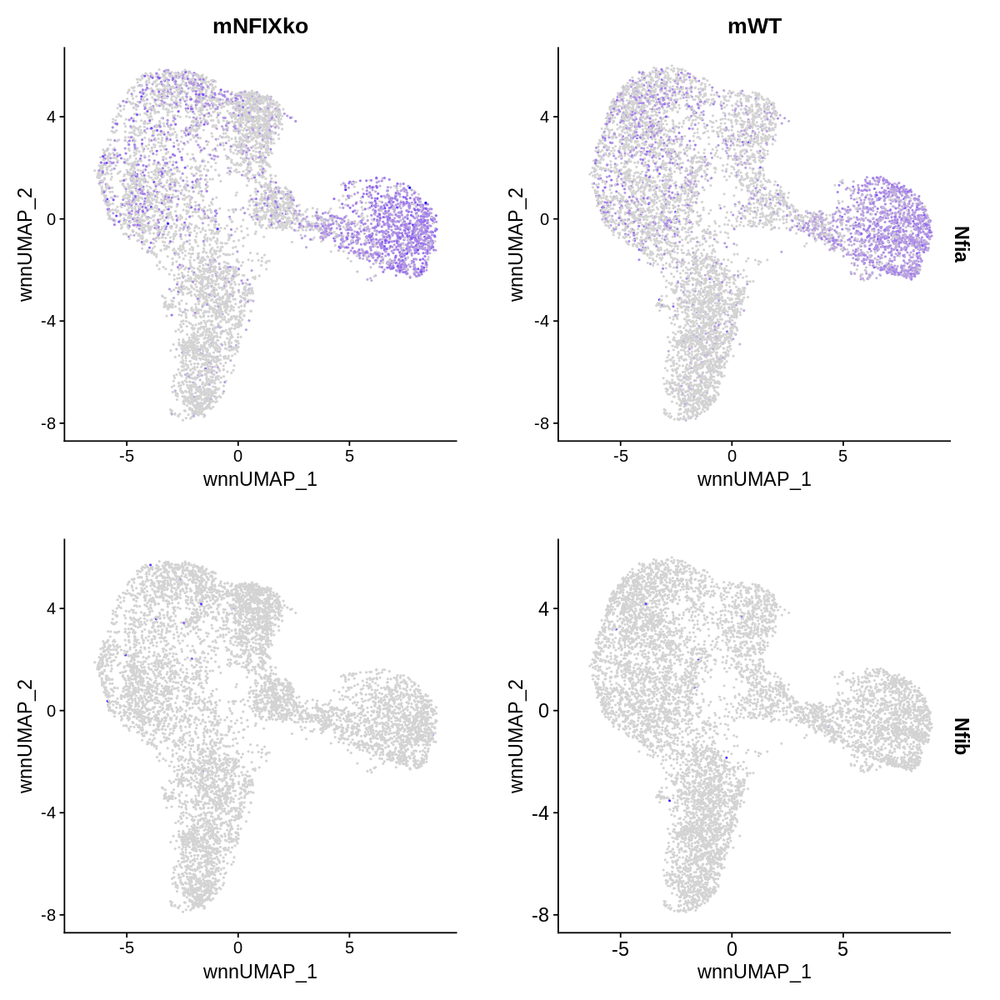

In [453]:
options(repr.plot.width = 10, repr.plot.height = 10)
FeaturePlot(merged_obj, features = c("Nfia","Nfib"), reduction = 'wnn.umap',ncol =4,split.by="orig.ident")+
theme(axis.text.x = element_text(size=14),
          axis.text.y = element_text(size=14))

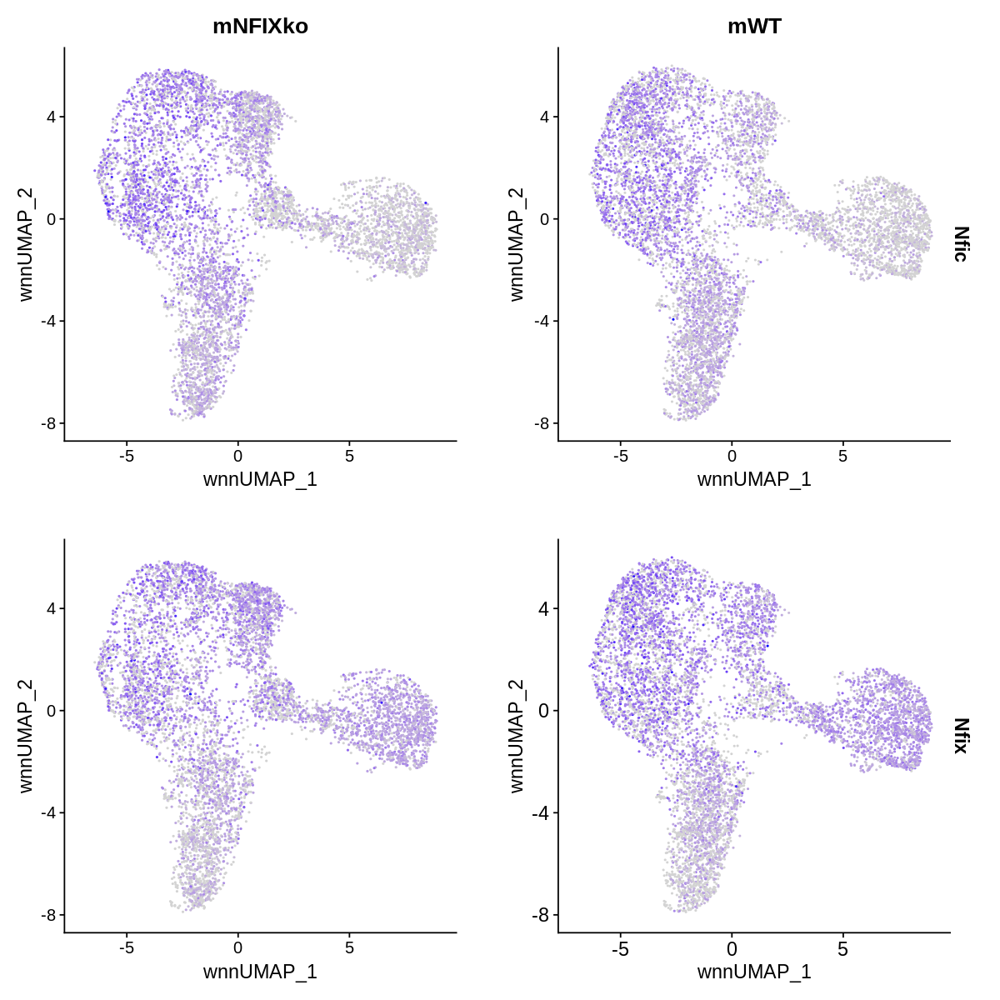

In [454]:
options(repr.plot.width = 10, repr.plot.height = 10)
FeaturePlot(merged_obj, features = c("Nfic","Nfix"), reduction = 'wnn.umap',ncol =4,split.by="orig.ident")+
theme(axis.text.x = element_text(size=14),
          axis.text.y = element_text(size=14))

In [ ]:
current.cluster.ids <- c(0, 1, 2, 3, 4, 5, 6, 7)
new.cluster.ids <- c("CD4 T cells", "CD14+ Monocytes", "B cells", "CD8 T cells", 
    "FCGR3A+ Monocytes", "NK cells", "Dendritic cells", "Megakaryocytes")
pbmc@ident <- plyr::mapvalues(x = merged_obj@active.ident, from = current.cluster.ids, to = new.cluster.ids)

In [34]:
clu_ann_Blood$cluster
clu_ann_Blood$cell_type

[1] "4"  "12" "15" "16"

[1] "Natural Killer Cell" "Dendritic Cell"      "Basophil"           
[4] "Regulatory T Cell"

In [42]:
merged_obj@meta.data$Blood_pred = plyr::mapvalues(x = merged_obj@active.ident, from = clu_ann_Blood$cluster, to = clu_ann_Blood$cell_type)

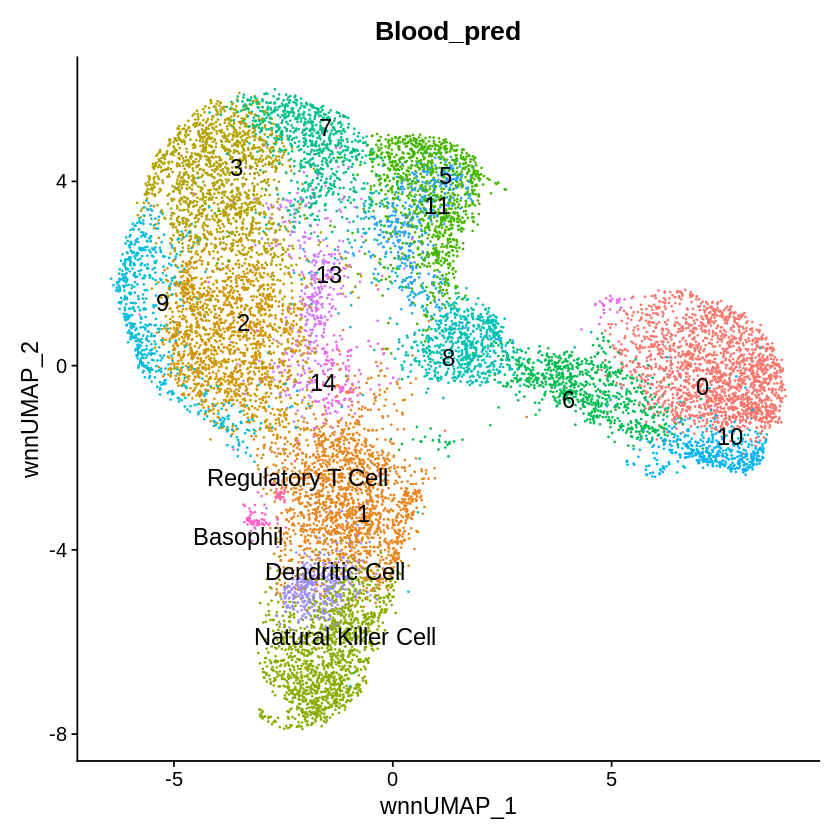

In [44]:
options(repr.plot.width = 7, repr.plot.height = 7)

DimPlot(merged_obj, reduction = 'wnn.umap', group.by="Blood_pred",label = TRUE, repel = TRUE, label.size = 5) + NoLegend()


In [45]:
merged_obj@meta.data$BM_pred = plyr::mapvalues(x = merged_obj@active.ident, from = clu_ann_BM$cluster, to = clu_ann_BM$cell_type)

In [46]:
merged_obj@meta.data$Bone_pred = plyr::mapvalues(x = merged_obj@active.ident, from = clu_ann_Bone$cluster, to = clu_ann_Bone$cell_type)

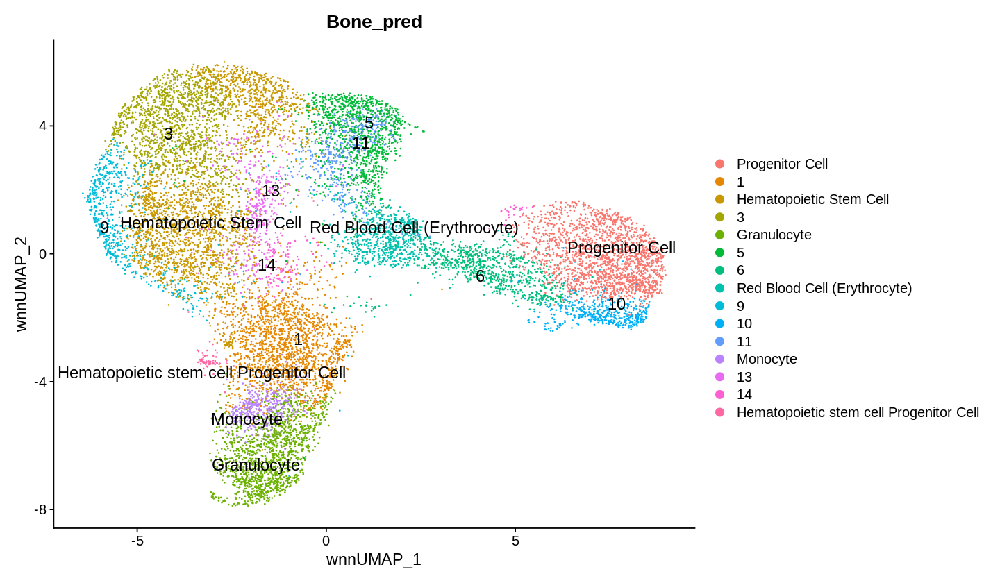

In [51]:
options(repr.plot.width = 12, repr.plot.height = 7)

DimPlot(merged_obj, reduction = 'wnn.umap', group.by="Bone_pred",label = T, repel = TRUE, label.size = 5)


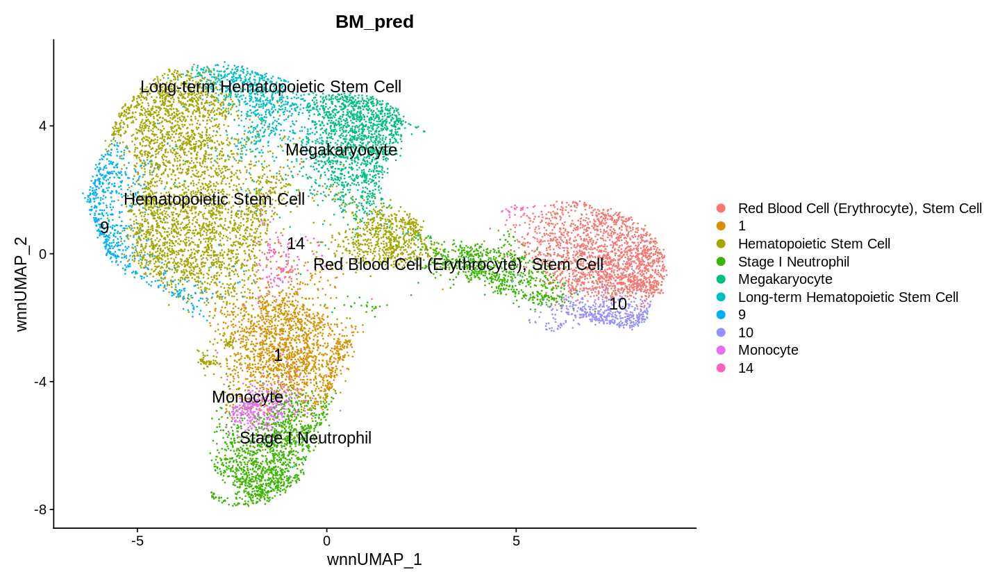

In [54]:
options(repr.plot.width = 12, repr.plot.height = 7)

DimPlot(merged_obj, reduction = 'wnn.umap', group.by="BM_pred",label = T, repel = TRUE, label.size = 5)


In [27]:
clu_ann_Blood

cluster,cluster_marker,cell_type,celltype_score,celltype_related_marker,PMID
<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>
4,"Fcgr3, Ncam1, Prtn3, Vcam1",Natural Killer Cell,0.58,"Fcgr3, Ncam1",28759029
12,"Bst2, Cd48, Igfbp4, Il3ra",Dendritic Cell,0.67,"Bst2, Il3ra","29217582, CD Handbook"
15,"Basp1, Fcer1a, Mcpt8",Basophil,0.67,"Mcpt8, Fcer1a","27932459, 24610714"
16,"B2m, Ccl5, Ccr2, Cd3d, Cd3g, Gzma, Itga2, Itgal, Itgax, Ncr1, Ptprc, Tcf7, Trbc2",Regulatory T Cell,0.84,"Tcf7, Trbc2",29217582


In [28]:
clu_ann_BM

cluster,cluster_marker,cell_type,celltype_score,celltype_related_marker,PMID
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
0,"Alad, Aqp1, Blvrb, Car1, Car2, Chchd10, Creg1, E2f4, Gata1, Hmgb3, Klf1, Mrpl52, Phb2, Picalm, Ranbp2, Rhd, Tfrc","Red Blood Cell (Erythrocyte), Stem Cell","0.73, 0.73","Car1, Car2, Gata1, Klf1, Aqp1, Ranbp2","29915358, 26627738, 27225119"
2,"Adgrl4, Cd27, Flt3, Gcnt2, Hlf, Lmo2, Ly6a, Myl10, Sox4, Stxbp4, Vldlr, Wfdc17, Zfp608",Hematopoietic Stem Cell,0.95,"Ly6a, Flt3, Gcnt2, Hlf, Vldlr","27009448, 27984734, 28479188, 28790449, 27365425, 27225119, 28584094"
3,"H2-Aa, Hacd4, Ifitm3, Itsn1, Mecom, Mllt3, Myof, Procr, Txnip",Hematopoietic Stem Cell,0.88,"Procr, Itsn1, Mllt3, Myof, Mecom","28479188, 27365425, 27225119, 28584094"
4,"Abca13, Anxa1, App, Arhgdib, C3, Ceacam1, Cebpe, Cemip2, Chil3, Ckap4, Clec4a2, Csf3r, Ctsg, Dgat2, Dstn, Elane, Fcgr3, Fcnb, Fgl2, Flot2, G0s2, Gca, Gda, Gfi1, Gstm1, Hmgn2, Hp, Hsd11b1, Igsf6, Lcn2, Ldhb, Lrg1, Lta4h, Ltb4r1, Mcemp1, Mgst2, Mpo, Mrgpra2b, Ms4a3, Msrb1, Nav2, Ncam1, Neu1, Ngp, Nhsl2, Per3, Pglyrp1, Prdx5, Prom1, Prss57, Prtn3, Pygl, Rflnb, Rgcc, Rhou, S100a11, S100a8, S100a9, Serpinb1a, Srgn, Tbc1d15, Tmem216, Tmem258, Trem3, Vat1, Vcam1, Wfdc21",Stage I Neutrophil,0.89,"Wfdc21, Abca13, Anxa1, C3, Ceacam1, Cebpe, Ckap4, Clec4a2, Dgat2, Dstn, Fcnb, Flot2, G0s2, Gca, Gda, Hp, Hsd11b1, Igsf6, Lcn2, Lrg1, Ltb4r1, Mgst2, Mrgpra2b, Ncam1, Ngp, Nhsl2, Pglyrp1, Prdx5, Pygl, Rhou, S100a11, S100a8, S100a9, Serpinb1a, Tmem216, Trem3, Mcemp1, Chil3, Rflnb, Cemip2",29915358
5,"Arrb2, Dusp3, Mat2a, Mef2c, Pbx1, Pf4, Timp3, Vwf",Megakaryocyte,0.85,"Pf4, Mef2c, Pbx1, Vwf","29915358, 26627738, 29466336, 29775597"
6,"Acsl1, Ass1, Gdf3, Plscr1",Stage I Neutrophil,0.58,"Acsl1, Plscr1",29915358
7,"Arhgap31, Esam, Gkn3, Meis1, Mmrn1, Mpl, Mycn, Smim6, Sult1a1, Tgm2, Tm4sf1, Tmem176a, Trim47, Uba7",Long-term Hematopoietic Stem Cell,0.84,"Esam, Mmrn1, Tgm2",27365425
8,"Apoe, Cd47, Clec4d, Gnb4, Slc22a3, Trib2",Hematopoietic Stem Cell,0.65,"Cd47, Apoe, Gnb4, Slc22a3, Trib2",27225119
11,"Cd9, Cited2, Dach1, Diaph1, Elf1, Fli1, Zfpm1",Megakaryocyte,0.61,"Cited2, Fli1, Zfpm1",26627738


In [30]:
clu_ann_Bone

cluster,cluster_marker,cell_type,celltype_score,celltype_related_marker,PMID
<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>
0,"Car1, Gata1, Klf1, Tfrc",Progenitor Cell,0.67,"Tfrc, Gata1","21847081, 27580035"
2,"Flt3, Hlf, Ly6a, Runx2, Sox4",Hematopoietic Stem Cell,0.71,"Hlf, Sox4",27580035
4,"Cebpe, Chd7, Csf3r, Elane, Far2, Gfi1, Med21, Mpo, S100a8, Sgms2, Trem3",Granulocyte,0.65,"Cebpe, Chd7, Far2, Gfi1, S100a8, Trem3",27580035
7,"Meis1, Mpl, Tsc22d1",Hematopoietic Stem Cell,0.61,"Meis1, Mpl, Tsc22d1",27580035
8,"Clec4d, Mfsd2b",Red Blood Cell (Erythrocyte),0.58,"Clec4d, Mfsd2b",27580035
12,"Csf1r, Cybb, Irf8, Slpi, Tfec",Monocyte,0.61,"Cybb, Irf8, Slpi",27580035
15,"Alox5, Cx3cr1, Gata2, Ikzf2, Il4, Prkcb, Slc45a3",Hematopoietic stem cell Progenitor Cell,0.61,"Alox5, Gata2, Ikzf2",27580035
16,"Batf3, Btg2, Ctla2a, Fosb, Ptprc, Slamf7, Thy1",Hematopoietic Stem Cell,0.75,"Btg2, Ctla2a, Fosb",27580035


In [57]:
m = read.table("markers.tsv",header=F,sep="\t")

In [62]:
FeaturePlot(merged_obj, features =strsplit(clu_ann_BM$celltype_related_marker[[1]],", ")[[1]], reduction = 'wnn.umap',title="test")

ERROR: Error in FeaturePlot(merged_obj, features = strsplit(clu_ann_BM$celltype_related_marker[[1]], : unused argument (title = "test")


In [68]:
figure_list = list()
for (row in 1:nrow(m)) {
    name=m[row,"V1"]
    genes=m[row,"V2"]
    figure_list[[row]] = FeaturePlot(merged_obj, features =strsplit(genes,", ")[[1]], reduction = 'wnn.umap')
}

Warning message:
“Could not find Batf3 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Ifi205 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Mycl in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Slamf7 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Epx in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Il15 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Il4 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Mpo in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Prg2 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Prg3 in the default search locations, found in RNA assay instead”
Warning 

In [73]:
for (row in 1:nrow(m)) {
    name=m[row,"V1"]
    genes=m[row,"V2"]
    FeaturePlot(merged_obj, features =strsplit(genes,", ")[[1]], reduction = 'wnn.umap')
    ggtitle(name)
    ggsave(paste(name, ".",row,".nfix.scRNA.png", sep=""))
}

Warning message:
“Could not find Batf3 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Ifi205 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Mycl in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Slamf7 in the default search locations, found in RNA assay instead”
Saving 6.67 x 6.67 in image

Warning message:
“Could not find Epx in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Il15 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Il4 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Mpo in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Prg2 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find Prg3 in the default search locations, found i

In [79]:
name

[1] "Macrophage and dendritic cell precursor cell"

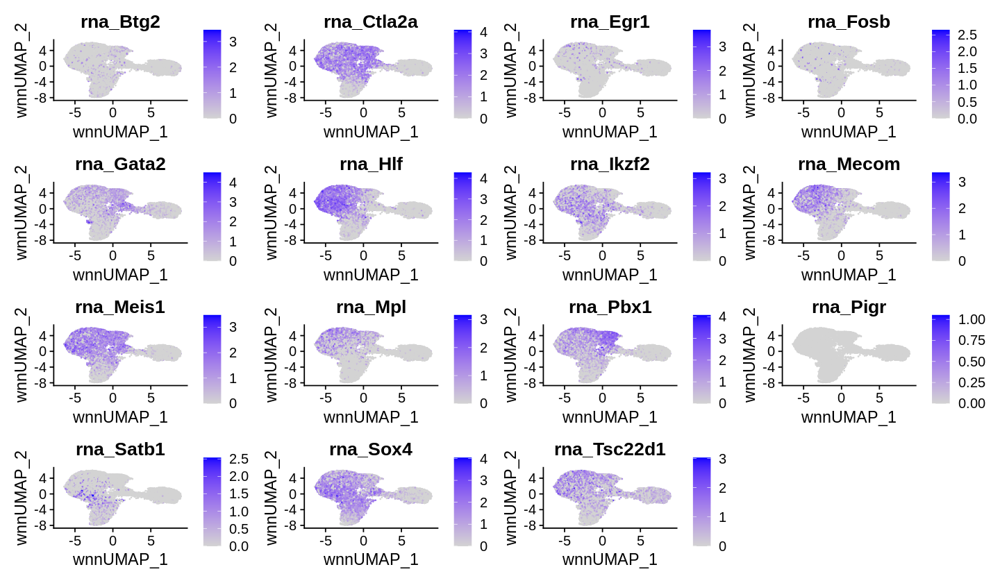

In [80]:
n=5
figure_list[[n]]
name=m[n,"V1"]


Warning message:
“Could not find Nfix in the default search locations, found in RNA assay instead”


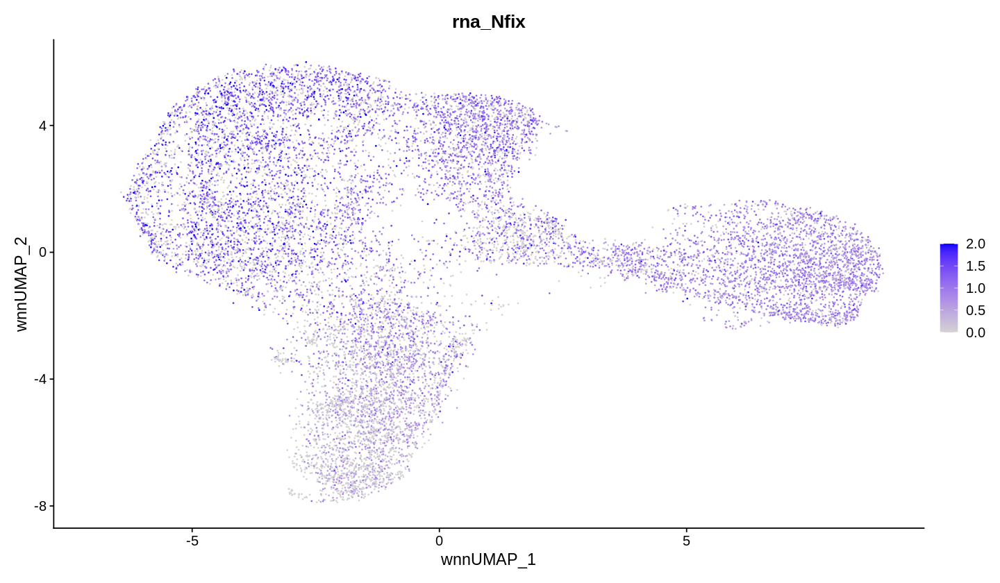

In [83]:
FeaturePlot(merged_obj, features = "Nfix", reduction = 'wnn.umap',max.cutoff=2)

Warning message:
“Could not find Nfic in the default search locations, found in RNA assay instead”


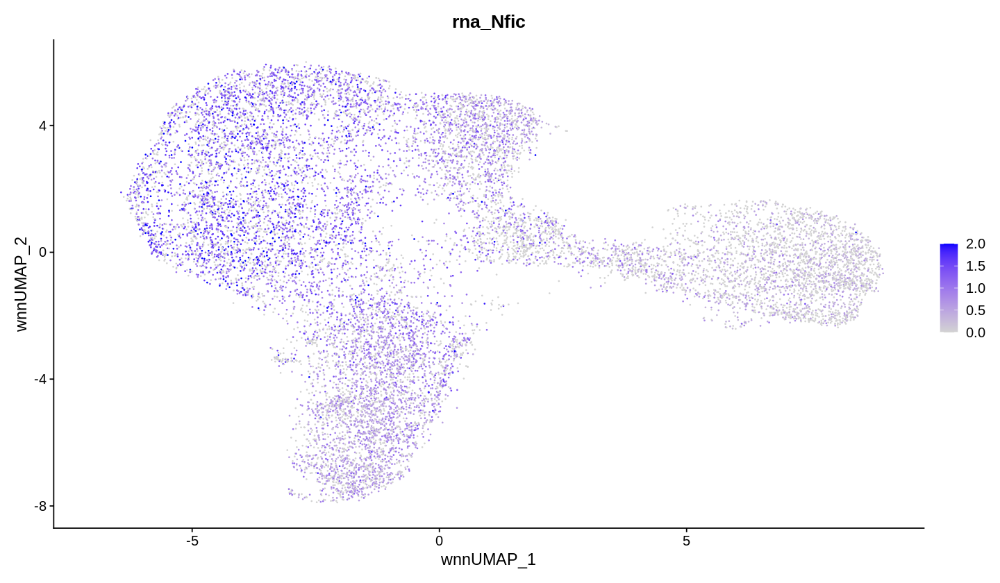

In [85]:
FeaturePlot(merged_obj, features = "Nfic", reduction = 'wnn.umap',max.cutoff=2)

In [90]:
x=table(merged_obj@active.ident, merged_obj@meta.data$orig.ident)
x

In [93]:
x
library(reshape2)

xx <- melt(x[,c('mNFIXko','mWT')],id.vars = 1)
xx

    
     mNFIXko mWT
  0      835 968
  1      781 952
  2      779 803
  3      488 987
  4      584 805
  5      657 432
  6      393 402
  7      470 308
  8      403 270
  9      281 378
  10     190 284
  11     255 197
  12     202 204
  13     135 244
  14      97  62
  15      37  32
  16      21  13


Attaching package: ‘reshape2’


The following object is masked from ‘package:tidyr’:

    smiths




Var1,Var2,value
<int>,<fct>,<int>
0,mNFIXko,835
1,mNFIXko,781
2,mNFIXko,779
3,mNFIXko,488
4,mNFIXko,584
5,mNFIXko,657
6,mNFIXko,393
7,mNFIXko,470
8,mNFIXko,403


In [117]:
sum(x$mNFIXko)

ERROR: Error in x$mNFIXko: $ operator is invalid for atomic vectors


mNFIXko     mWT 
   6608    7341

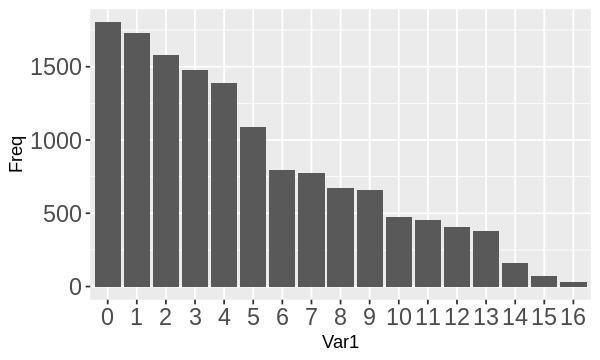

In [440]:
options(repr.plot.width = 5, repr.plot.height = 3)

xx=as.data.frame(table(merged_obj@active.ident))
ggplot(xx,aes(x = Var1,y = Freq))+geom_bar(stat = "identity",position = "dodge")+
theme(axis.text.x = element_text(size=14),
          axis.text.y = element_text(size=14))+NoLegend()

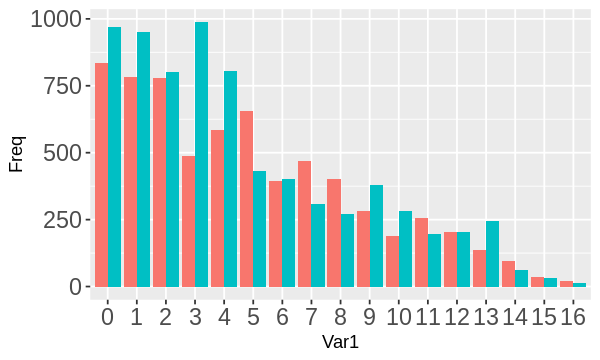

In [441]:

xx=as.data.frame(table(merged_obj@active.ident, merged_obj@meta.data$orig.ident))
ggplot(xx,aes(x = Var1,y = Freq))+geom_bar(aes(fill = Var2),stat = "identity",position = "dodge")+
theme(axis.text.x = element_text(size=14),
          axis.text.y = element_text(size=14))+NoLegend()

In [129]:
xx = as.data.frame(x/colSums(x))
xx

Var1,Var2,Freq
<fct>,<fct>,<dbl>
0,mNFIXko,0.126361985
1,mNFIXko,0.106388775
2,mNFIXko,0.117887409
3,mNFIXko,0.066475957
4,mNFIXko,0.088377724
5,mNFIXko,0.089497344
6,mNFIXko,0.059473366
7,mNFIXko,0.064023975
8,mNFIXko,0.060986683


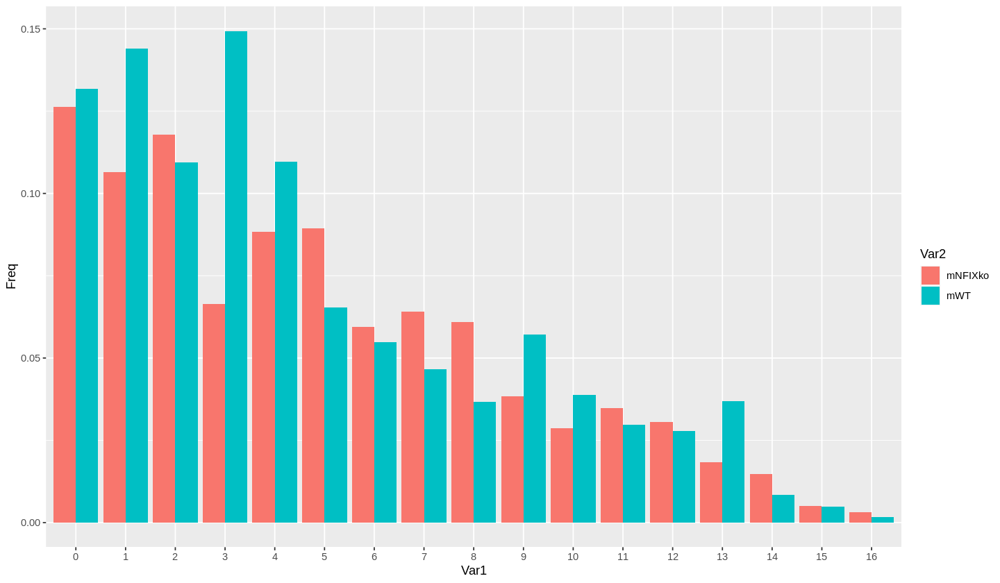

In [131]:


ggplot(xx,aes(x = Var1,y = Freq)) + 
    geom_bar(aes(fill = Var2),stat = "identity",position = "dodge")

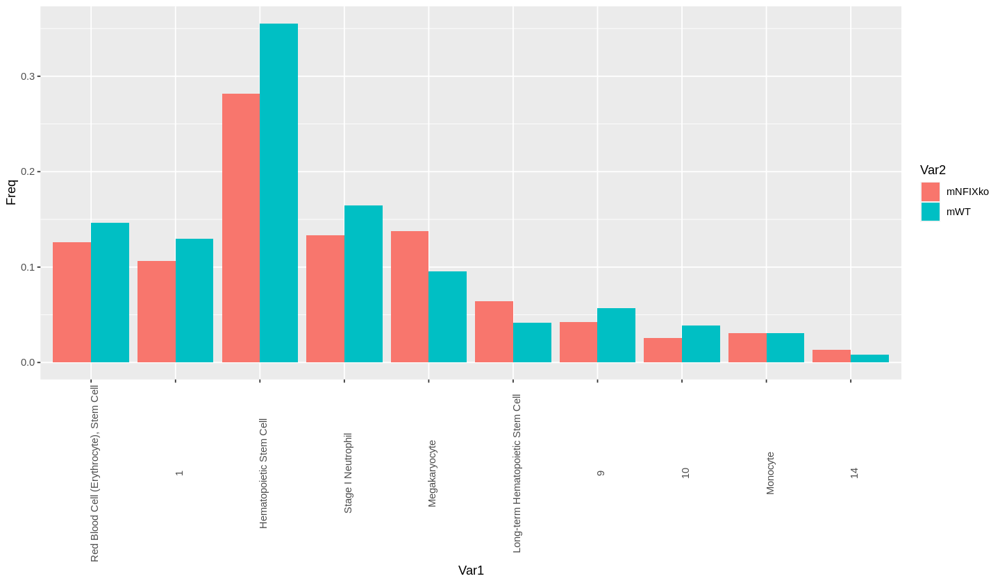

In [135]:
x=table(merged_obj@meta.data$BM_pred, merged_obj@meta.data$orig.ident)
xx = as.data.frame(x/colSums(x))
ggplot(xx,aes(x = Var1,y = Freq)) + 
    geom_bar(aes(fill = Var2),stat = "identity",position = "dodge")+theme(axis.text.x = element_text(angle = 90))

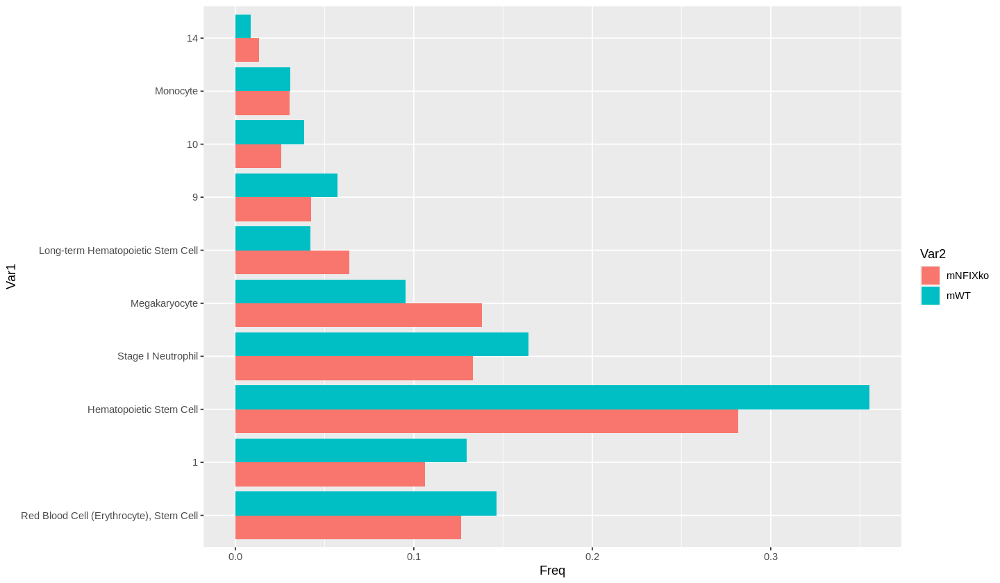

In [136]:
x=table(merged_obj@meta.data$BM_pred, merged_obj@meta.data$orig.ident)
xx = as.data.frame(x/colSums(x))
ggplot(xx,aes(y = Var1,x = Freq)) + 
    geom_bar(aes(fill = Var2),stat = "identity",position = "dodge")

Warning message in DoHeatmap(merged_obj, features = features):
“The following features were omitted as they were not found in the scale.data slot for the RNA assay: Kcnip3, CD135, CD115, Tsc22d1, Ptrf, Pigr, Meis1, Gm17757, Csf1, Tmem53, Tanc1, Mapk31, Lyz1, Il4, Il15”


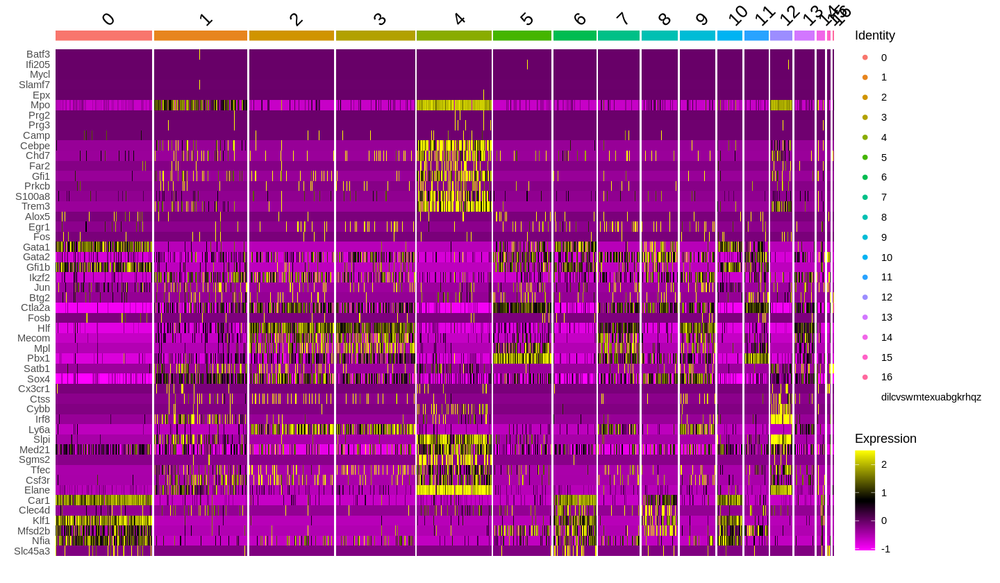

In [140]:
features = c("Batf3","Ifi205","Mycl","Slamf7","Epx","Il15","Il4","Mpo","Prg2","Prg3","Camp","Cebpe","Chd7","Far2","Gfi1","Lyz1","Mapk31","Prkcb","S100a8","Tanc1","Tmem53","Trem3","Alox5","Csf1","Egr1","Fos","Gata1","Gata2","Gfi1b","Ikzf2","Jun","Btg2","Ctla2a","Egr1","Fosb","Gata2","Gm17757","Hlf","Ikzf2","Mecom","Meis1","Mpl","Pbx1","Pigr","Ptrf","Satb1","Sox4","Tsc22d1","CD115","CD135","Cx3cr1","Ctss","Cybb","Irf8","Ly6a","Slpi","Kcnip3","Med21","Sgms2","Tfec","Cebpe","Csf3r","Elane","Gfi1","Car1","Clec4d","Gata1","Gfi1b","Klf1","Mfsd2b","Nfia","Slc45a3")
DefaultAssay(merged_obj) = "RNA"
DoHeatmap(merged_obj, features = features) 

In [141]:
save.image("6_17.RData")

Warning message:
“Could not find CD105-TotalA in the default search locations, found in ADT assay instead”


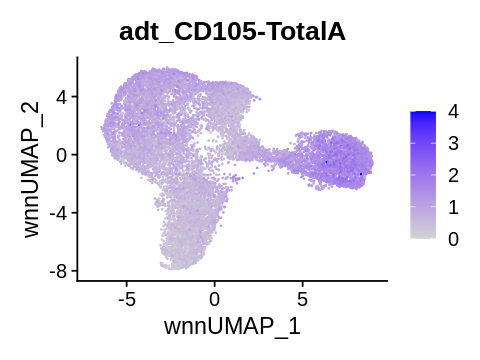

In [150]:
options(repr.plot.width = 4, repr.plot.height = 3)

FeaturePlot(merged_obj, features = "CD105-TotalA", reduction = 'wnn.umap',max.cutoff=4)

In [212]:

tmp = subset(x = merged_obj, subset = seurat_clusters == 1)
cluster1 = FindMarkers(tmp, ident.1 = "mWT", ident.2 = "mNFIXko",group.by="orig.ident",logfc.threshold = 0.5)
cluster1

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Echdc2,8.984981e-69,0.5639533,0.348,0.010,2.790106e-64
Gm42418,9.194370e-66,-0.6119461,1.000,1.000,2.855128e-61
Gm47283,1.905077e-38,0.5171424,0.468,0.197,5.915836e-34
Lgals1,1.739312e-30,0.5903460,0.872,0.738,5.401085e-26
Ly6c2,1.228583e-12,0.6797153,0.294,0.159,3.815118e-08
Mpo,4.429524e-12,0.5112251,0.887,0.840,1.375500e-07
Elane,4.508407e-11,0.8135476,0.680,0.556,1.399996e-06


In [239]:
for (c in levels(merged_obj)){
    tmp = subset(x = merged_obj, subset = seurat_clusters == c)
    degs = FindMarkers(tmp, ident.1 = "mWT", ident.2 = "mNFIXko",group.by="orig.ident",logfc.threshold = 0.5)
    
    write.table(degs,paste("Cluster",c,".DEG.orig.ident.tsv",sep="\t"))
    degs = degs[degs$p_val_adj<=0.1,]
    if (dim(degs)[1]==0){next}
    # UMAP plot
    wt1 = WhichCells(merged_obj, expression = orig.ident == "mWT" & seurat_clusters==c)
    ko1 = WhichCells(merged_obj, expression = orig.ident == "mNFIXko" & seurat_clusters==c)

    DimPlot(merged_obj,reduction = 'wnn.umap', label=T, cells.highlight= list("mNFIXko"=ko1, "mWT"=wt1), 
        cols.highlight = list("#E64B35","#4DBBD5"), cols= "grey100",repel = T, label.size = 5)+
        scale_colour_manual(values = c("mNFIXko"="#E64B35","mWT"="#4DBBD5"))
    ggsave(paste("Cluster",c,".UMAP.orig.ident.png", sep=""))
    # Vlnplot
    VlnPlot(tmp, features = rownames(degs),group.by="orig.ident",ncol=4,cols=c("mNFIXko"="#E64B35","mWT"="#4DBBD5"))+ NoLegend()
    ggsave(paste("Cluster",c,".Vln.orig.ident.png", sep=""))
}

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Saving 6.67 x 6.67 in imag

In [240]:
# add other data

In [241]:
load("NicheData10x.rda")
NicheData10x <- FindVariableFeatures(object = NicheData10x)
NicheData10x <- ScaleData(object = NicheData10x)
NicheData10x <- RunPCA(object = NicheData10x)

Centering and scaling data matrix

PC_ 1 
Positive:  Hmgb3, Dut, Rrm2, Rfc4, Mcm7, Car2, Ctse, Rrm1, Birc5, Cd24a 
	   Atpif1, Gypa, Anp32b, Glrx5, Hmbs, Ddx39, Rhd, Tmem14c, Fen1, Hba-a1 
	   Tuba4a, Gmnn, Tipin, Ccnb2, Klf1, Hba-a2, Mcm2, Tk1, Cdca3, Alad 
Negative:  Tuba1a, Fos, Serpinh1, Cd9, Bgn, Serping1, Sparc, Cd63, Pcolce, Col1a2 
	   Fstl1, Cst3, Col6a1, Nupr1, Selm, Gpx8, Timp2, Crip1, Igfbp7, Sepp1 
	   Islr, Rcn3, Rarres2, Ecm1, Id3, Cd302, Dcn, Ctsl, Fxyd1, Igfbp5 
PC_ 2 
Positive:  Arhgdib, Plac8, Alox5ap, Srgn, Cd52, Tyrobp, Fcer1g, H2afy, Mpo, Clec12a 
	   Cyba, Selplg, Prtn3, Lyz2, Ly6c2, Ncf4, Ptprcap, Serpinb1a, Slpi, Ctsg 
	   Emb, Glipr1, BC035044, Igsf6, Nkg7, Fcgr3, Ms4a6c, Ccl9, Adssl1, Trem3 
Negative:  Fth1, Smim1, Cpox, Ctse, Gypa, Rhd, Nxpe2, Lmna, Hebp1, Gstm5 
	   Slc38a5, Mgst3, Cldn13, Rhag, Hemgn, Tspan33, Ermap, Klf1, Crip2, Trim10 
	   Tspan8, Paqr9, Asb17os, Hba-a2, Fech, Slc4a1, Blvrb, Prnp, Serpinh1, Aldh1a1 
PC_ 3 
Positive:  Serping1, Bgn, Serpi

In [242]:
merged_obj

An object of class Seurat 
31061 features across 13949 samples within 2 assays 
Active assay: RNA (31053 features, 2000 variable features)
 1 other assay present: ADT
 3 dimensional reductions calculated: pca, apca, wnn.umap

In [408]:
anchors <- FindTransferAnchors(
  reference = merged_obj,
  query = NicheData10x,
  reference.reduction = "pca",
  dims =1:50  
)


Projecting cell embeddings

Finding neighborhoods

Finding anchors

	Found 4241 anchors

Filtering anchors

	Retained 3183 anchors



In [311]:
NicheData10x <- TransferData(
  anchorset = anchors, 
  reference = merged_obj,
  query = NicheData10x,
  refdata = merged_obj@active.ident
)
NicheData10x <- IntegrateEmbeddings(
  anchorset = anchors,
  reference = merged_obj,
  query = NicheData10x, 
  new.reduction.name = "ref.pca2"
)


Finding integration vectors

Finding integration vector weights

Predicting cell labels

Integrating dataset 2 with reference dataset

Finding integration vectors

Integrating data

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from ref.pca2_ to refpca2_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from ref.pca2_ to refpca2_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to refpca2_”


In [249]:
NicheData10x$id

ERROR: Error: Cannot find 'id' in this Seurat object


00:26:46 UMAP embedding parameters a = 0.9922 b = 1.112

00:26:47 Read 21446 rows and found 50 numeric columns

00:26:47 Using Annoy for neighbor search, n_neighbors = 30

00:26:47 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

00:26:49 Writing NN index file to temp file /tmp/RtmpYARAy7/filead222d3431f3

00:26:49 Searching Annoy index using 1 thread, search_k = 3000

00:26:55 Annoy recall = 100%

00:26:56 Commencing smooth kNN distance calibration using 1 thread

00:26:58 Initializing from normalized Laplacian + noise

00:26:59 Commencing optimization for 200 epochs, with 942666 positive edges

00:27:24 Optimization finished



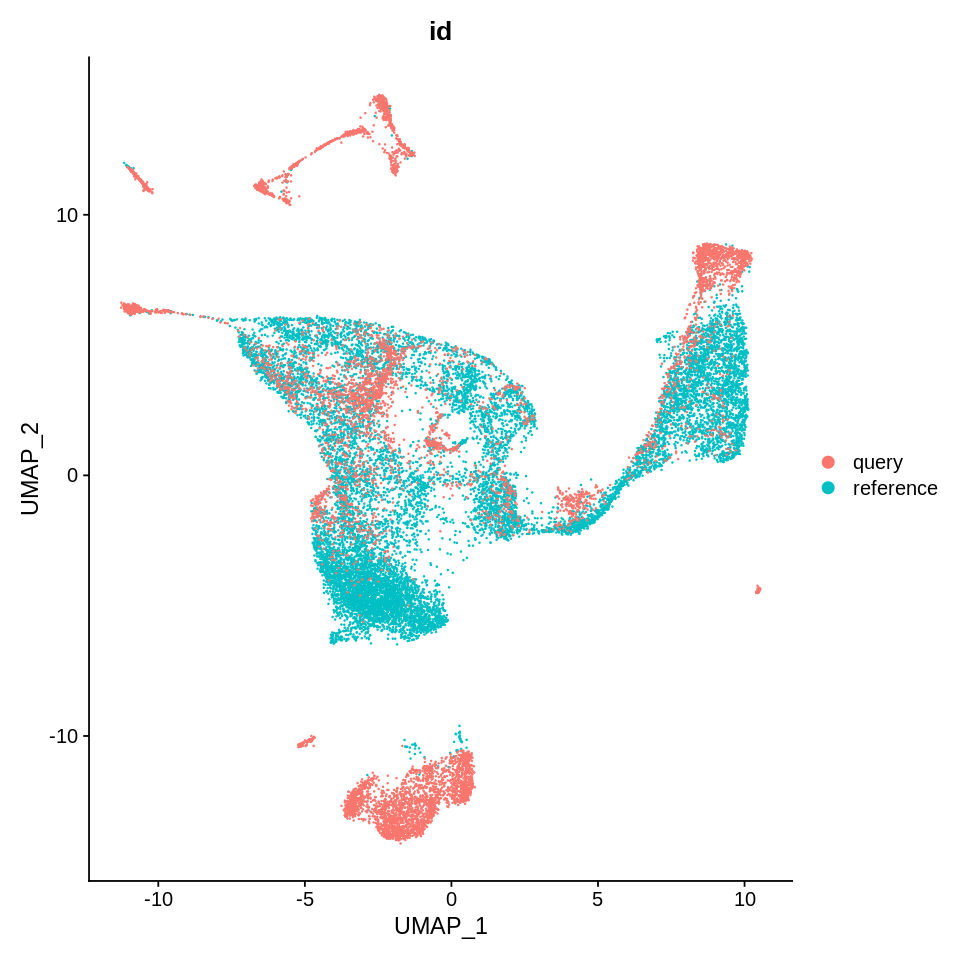

In [312]:
merged_obj$id <- 'reference'
NicheData10x$id <- 'query'
refquery <- merge(merged_obj, NicheData10x)
refquery[["pca"]] <- merge(merged_obj[["pca"]], NicheData10x[["ref.pca2"]])
refquery <- RunUMAP(refquery, reduction = 'pca', dims = 1:50)
DimPlot(refquery, group.by = 'id')

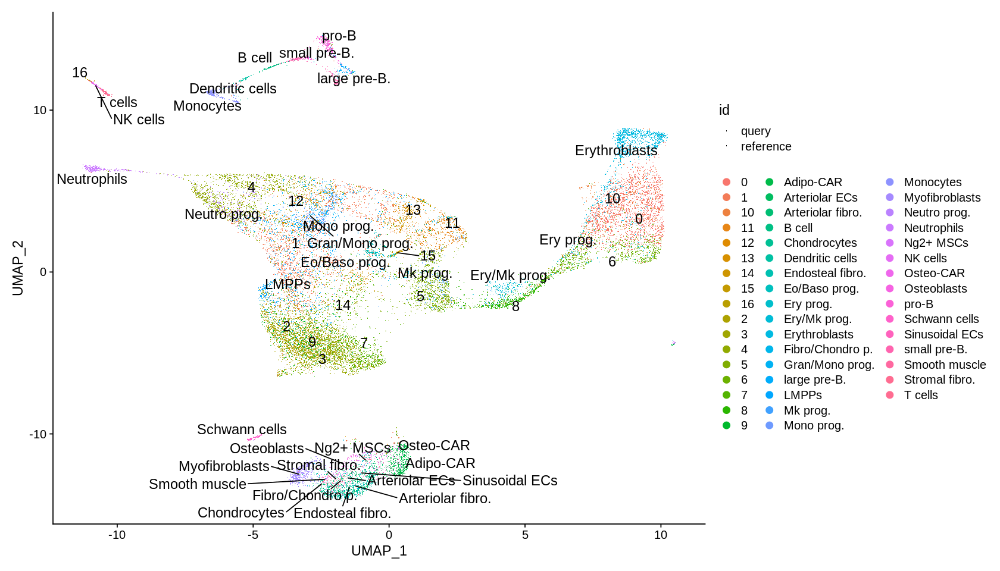

In [324]:
library(ggrepel)
options(repr.plot.width = 14, repr.plot.height = 8)
# DimPlot(merged_obj, reduction = 'wnn.umap', group.by="BM_pred",label = T, repel = TRUE, label.size = 5)
options(ggrepel.max.overlaps = Inf,ggrepel.box.padding = 0.5)
DimPlot(refquery, shape.by = 'id',label = T, repel = TRUE, label.size = 5)
# geom_text_repel(box.padding = 0.5, max.overlaps = Inf)

In [325]:
# add bulk RNA

In [411]:
myList = list()
bulk_list = c("HPC5_KO","HPC5_WT","LSK_KO","LSK_WT")
for(i in 1:length(bulk_list)){
    label = bulk_list[i]
    data <- read.table(paste("mouse_bulk/",label,".tsv",sep=""),row.names=1,header = T,sep="\t")
    myList[[i]]  <- CreateSeuratObject(counts = data, project = label, assay = "RNA")
    myList[[i]]$data_type = label
}




In [412]:

bulk_rnaseq = merge(myList[[1]], y = myList[2:4],add.cell.ids = bulk_list)

In [378]:
bulk_rnaseq@meta.data

,orig.ident,nCount_RNA,nFeature_RNA,data_type
,<chr>,<dbl>,<int>,<chr>
HPC5_KO_X1706788_MW112_2B9_2_S90_L003.tpm,X1706788,1000000.0,20092,HPC5_KO
HPC5_KO_X1706787_MW112_2B9_1_S89_L003.tpm,X1706787,1000000.0,21540,HPC5_KO
HPC5_KO_X1706789_MW112_2B9_3_S91_L003.tpm,X1706789,1000000.0,19730,HPC5_KO
HPC5_KO_HPC5_KO_random_0,HPC5,999935.0,25116,HPC5_KO
HPC5_KO_HPC5_KO_random_1,HPC5,1000044.4,25059,HPC5_KO
HPC5_KO_HPC5_KO_random_2,HPC5,999904.3,25076,HPC5_KO
HPC5_KO_HPC5_KO_random_3,HPC5,999921.9,24960,HPC5_KO
HPC5_KO_HPC5_KO_random_4,HPC5,999884.3,25098,HPC5_KO
HPC5_KO_HPC5_KO_random_5,HPC5,1000066.0,25209,HPC5_KO


In [401]:

# bulk_rnaseq <- FindVariableFeatures(object = bulk_rnaseq)
# bulk_rnaseq <- ScaleData(object = bulk_rnaseq)
bulk_rnaseq <- RunPCA(object = bulk_rnaseq)

Warning message in eval(predvars, data, env):
“NaNs produced”
Warning message in hvf.info$variance.expected[not.const] <- 10^fit$fitted:
“number of items to replace is not a multiple of replacement length”
Centering and scaling data matrix

PC_ 1 
Positive:  Gm15662, Csda, Hist1h2bl, Eltd1, Leng8, Gpr56, 2310045N01Rik, Rpl15-ps3, 4930431F12Rik, Setd8 
	   Tmc5, Gltscr2, E330020D12Rik, Mpl, Spnb2, Msi2, Gm12563, BC057079, Hist1h1e, Fam65a 
	   Rps3a, Gm15501, Fam65b, AY036118, Hist1h1b, Gm17684, Zbtb20, Lrrc33, Gm10163, Gm11161 
Negative:  Rpl15, Cfl1, Eif4a1, Serbp1, Cd63, Hnrnpf, Rps3, Eif5a, Tyrobp, Eef1g 
	   Slc25a5, Taldo1, Gm4332, Rpl18a, Gm2000, Tubb4b, Cct2, Rbm3, Arpc2, Arpc3 
	   Ncl, Set, Sumo2, Rps23-ps1, Eef1b2, Usmg5, Stmn1, Hnrnpc, Ftl1, Cox6c 
PC_ 2 
Positive:  Rplp2, Echdc2, Rpl13, Igkv15-103, Zfyve20, Rpl36, Rpl28, Ighv7-1, Gm13654, Rps26 
	   Gm10491, Rpl10a, Tsix, Vprbp, Hist1h2bb, Rps23, Ighj1, Gm10159, Rps12, Rbm39 
	   Grip2, Ngp, Uba52, Gm13826, Mid1, AA474408, 

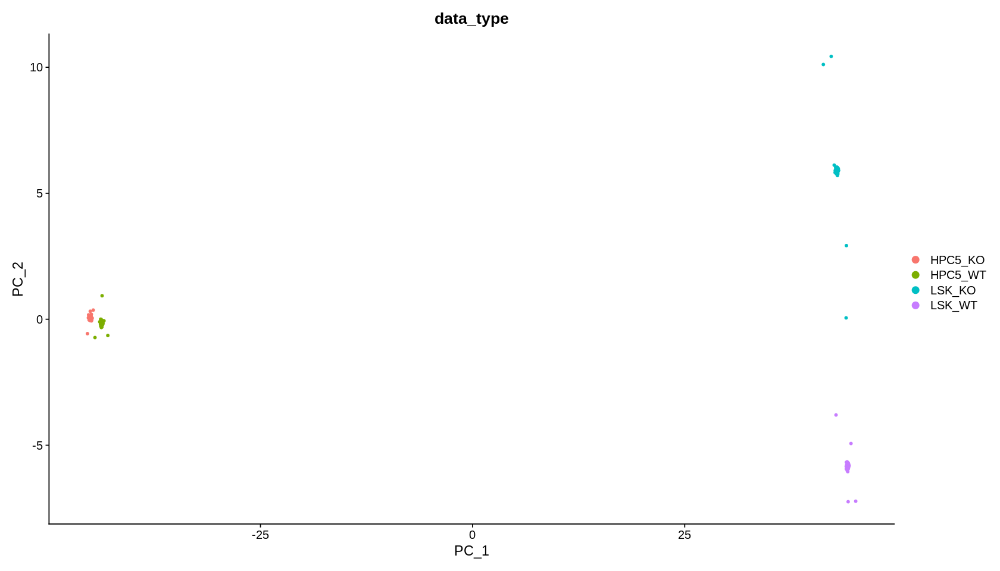

In [402]:
DimPlot(bulk_rnaseq,group.by="data_type")

In [413]:
anchors <- FindTransferAnchors(
  reference = merged_obj,
  query = bulk_rnaseq,
  reference.reduction = "pca",
  dims =1:50  
)


Projecting cell embeddings

Finding neighborhoods

Finding anchors

	Found 67 anchors

Filtering anchors

	Retained 63 anchors



In [396]:
anchors

An AnchorSet object containing 54 anchors between the reference and query Seurat objects. 
 This can be used as input to TransferData.

In [414]:
bulk_rnaseq <- TransferData(
  anchorset = anchors, 
  reference = merged_obj,
  query = bulk_rnaseq,
  refdata = merged_obj@active.ident,
    k.weight=30
)

Finding integration vectors

Finding integration vector weights

Predicting cell labels



In [415]:

bulk_rnaseq <- IntegrateEmbeddings(
  anchorset = anchors,
  reference = merged_obj,
  query = bulk_rnaseq, 
  new.reduction.name = "ref.pca2"
)


Integrating dataset 2 with reference dataset

Warning message in RunIntegration(filtered.anchors = filtered.anchors, reference = reference, :
“Number of anchors is less than k.weight. Lowering k.weight for sample pair.”
Finding integration vectors

Integrating data

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from ref.pca2_ to refpca2_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from ref.pca2_ to refpca2_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to refpca2_”


10:11:46 UMAP embedding parameters a = 0.9922 b = 1.112

10:11:46 Read 14163 rows and found 30 numeric columns

10:11:46 Using Annoy for neighbor search, n_neighbors = 30

10:11:46 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

10:11:50 Writing NN index file to temp file /tmp/RtmpYARAy7/filead222cdb97e8

10:11:50 Searching Annoy index using 1 thread, search_k = 3000

10:11:55 Annoy recall = 100%

10:11:56 Commencing smooth kNN distance calibration using 1 thread

10:11:58 Initializing from normalized Laplacian + noise

10:11:59 Commencing optimization for 200 epochs, with 594220 positive edges

10:12:15 Optimization finished



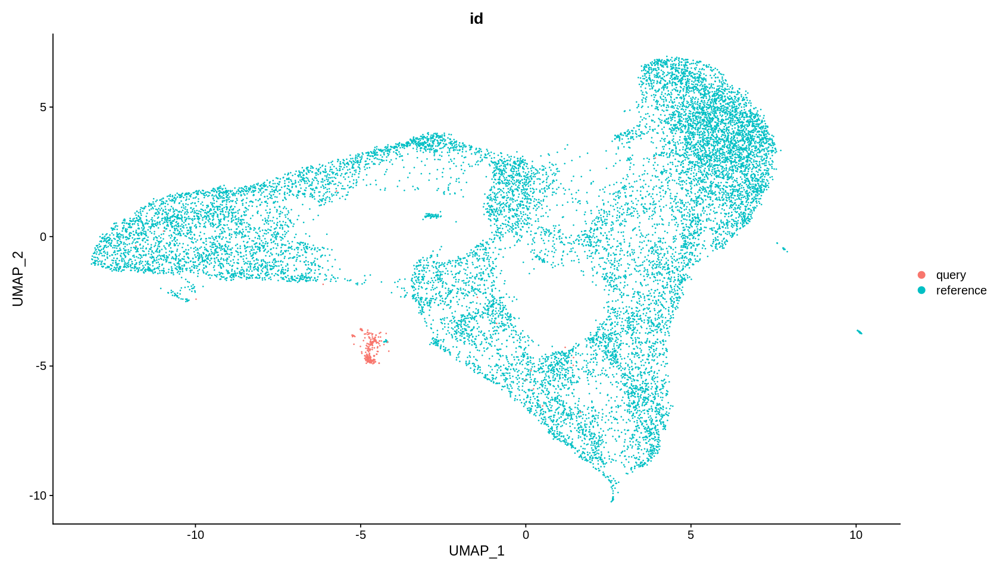

In [416]:
merged_obj$id <- 'reference'
bulk_rnaseq$id <- 'query'
refquery2 <- merge(merged_obj, bulk_rnaseq)
refquery2[["pca"]] <- merge(merged_obj[["pca"]], bulk_rnaseq[["ref.pca2"]])
refquery2 <- RunUMAP(refquery2, reduction = 'pca', dims = 1:30)
DimPlot(refquery2, group.by = 'id')

In [419]:
refquery2@meta.data

,orig.ident,nCount_RNA,nFeature_RNA,nCount_ADT,nFeature_ADT,percent.mt,RNA.weight,ADT.weight,wsnn_res.1,seurat_clusters,Blood_pred,BM_pred,Bone_pred,id,data_type,predicted.id.score,predicted.id
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>
mWT_AAACCCAAGTGATCGG-1,mWT,3787,1690,103,7,5.307631,0.129729865,0.87027014,9,9,9,9,9,reference,NA,NA,NA
mWT_AAACCCACAAACCATC-1,mWT,13420,3991,284,8,3.204173,0.040801805,0.95919820,3,3,3,Hematopoietic Stem Cell,3,reference,NA,NA,NA
mWT_AAACCCACACTGTCCT-1,mWT,20299,4446,208,7,1.059165,0.135924221,0.86407578,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference,NA,NA,NA
mWT_AAACCCACAGCCATTA-1,mWT,11463,3649,180,8,2.852656,0.118308303,0.88169170,9,9,9,9,9,reference,NA,NA,NA
mWT_AAACCCAGTACCTAAC-1,mWT,22463,5146,414,8,3.770645,0.001217896,0.99878210,5,5,5,Megakaryocyte,5,reference,NA,NA,NA
mWT_AAACCCAGTCCTCCTA-1,mWT,28107,5085,196,8,1.946134,0.093460246,0.90653975,6,6,6,Stage I Neutrophil,6,reference,NA,NA,NA
mWT_AAACCCAGTGAATTAG-1,mWT,19208,4646,341,8,5.731987,0.927617106,0.07238289,13,13,13,Hematopoietic Stem Cell,13,reference,NA,NA,NA
mWT_AAACCCAGTTCTCTCG-1,mWT,19647,4037,221,7,4.535044,0.394569243,0.60543076,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference,NA,NA,NA
mWT_AAACCCATCAAATGAG-1,mWT,18893,4245,389,8,4.340232,0.241141305,0.75885870,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference,NA,NA,NA


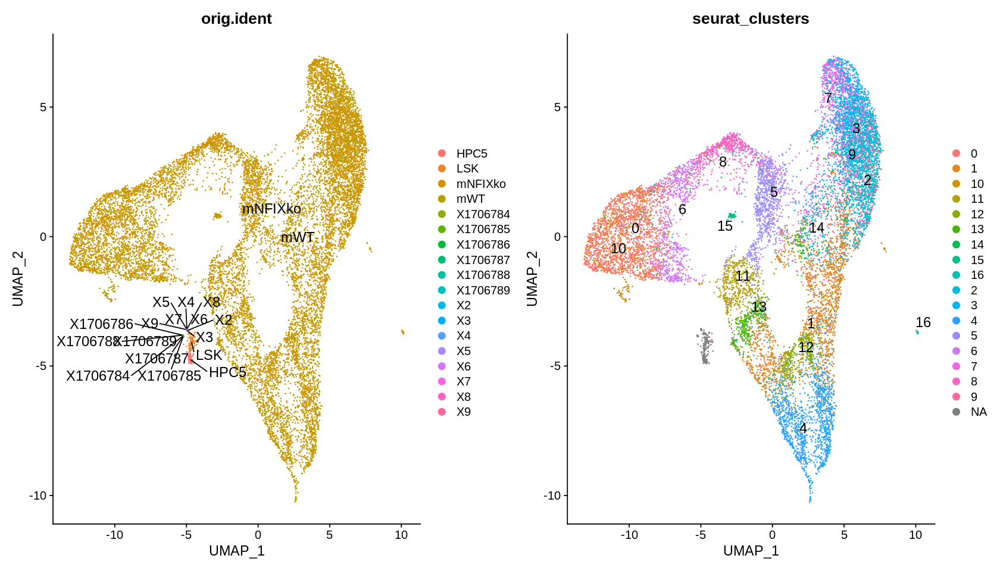

In [421]:
library(ggrepel)
options(repr.plot.width = 14, repr.plot.height = 8)
# DimPlot(merged_obj, reduction = 'wnn.umap', group.by="BM_pred",label = T, repel = TRUE, label.size = 5)
options(ggrepel.max.overlaps = Inf,ggrepel.box.padding = 0.5)
DimPlot(refquery2,group.by=c("orig.ident","seurat_clusters"),label = T, repel = TRUE, label.size = 5)
# geom_text_repel(box.padding = 0.5, max.overlaps = Inf)

In [409]:
merged_obj$id <- 'reference'
bulk_rnaseq$id <- 'query'
refquery2 <- merge(merged_obj, bulk_rnaseq)
refquery2[["pca"]] <- merge(merged_obj[["pca"]], bulk_rnaseq[["ref.pca2"]])

In [426]:
library(SeuratDisk)
# library(SeuratWrappers)
DefaultAssay(merged_obj) <- "RNA"
SaveH5Seurat(merged_obj, filename = "mouseBM.h5Seurat")
Convert("mouseBM.h5Seurat", dest = "h5ad")

Creating h5Seurat file for version 3.1.5.9900

Adding counts for RNA

Adding data for RNA

Adding scale.data for RNA

Adding variable features for RNA

Adding feature-level metadata for RNA

Adding counts for ADT

Adding data for ADT

Adding scale.data for ADT

Adding variable features for ADT

No feature-level metadata found for ADT

Adding cell embeddings for pca

Adding loadings for pca

No projected loadings for pca

Adding standard deviations for pca

No JackStraw data for pca

Adding cell embeddings for apca

Adding loadings for apca

No projected loadings for apca

Adding standard deviations for apca

No JackStraw data for apca

Adding cell embeddings for wnn.umap

No loadings for wnn.umap

No projected loadings for wnn.umap

No standard deviations for wnn.umap

No JackStraw data for wnn.umap

Validating h5Seurat file

Adding scale.data from RNA as X

Transfering meta.features to var

Adding data from RNA as raw

Transfering meta.features to raw/var

Transfering meta.data to obs

In [427]:
remotes::install_github('satijalab/seurat-wrappers')


spatstat.... (2.1-2   -> 2.2-0  ) [CRAN]
plotly       (4.9.4   -> 4.9.4.1) [CRAN]
rsvd         (NA      -> 1.0.5  ) [CRAN]
remotes      (2.3.0   -> 2.4.0  ) [CRAN]
BiocManager  (1.30.15 -> 1.30.16) [CRAN]


Installing 5 packages: spatstat.core, plotly, rsvd, remotes, BiocManager

Warning message in install(source, dependencies = dependencies, upgrade = upgrade, :
“internal error -3 in R_decompress1”
Warning message in install(source, dependencies = dependencies, upgrade = upgrade, :
“internal error -3 in R_decompress1”
Warning message in stop(remote_install_error(remotes[[i]], e)):
“internal error -3 in R_decompress1”


ERROR: Error in stop(remote_install_error(remotes[[i]], e)): lazy-load database '/research/rgs01/home/clusterHome/yli11/.conda/envs/captureC/lib/R/library/remotes/R/remotes.rdb' is corrupt


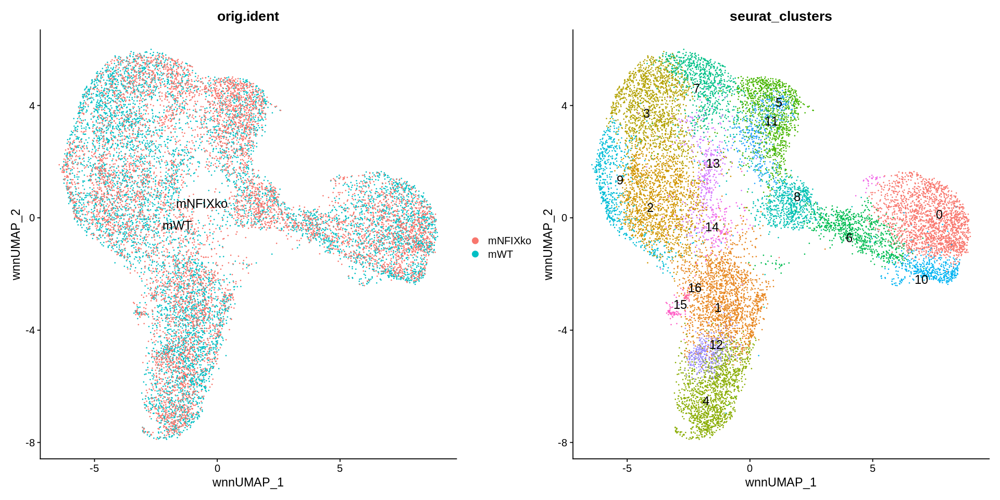

In [428]:
options(repr.plot.width = 16, repr.plot.height = 8)
DimPlot(merged_obj,group.by=c("orig.ident","seurat_clusters"),reduction = 'wnn.umap',label = T, repel = TRUE, label.size = 5)+NoLegend()


In [455]:
deg_list = c("Gm42418","Echdc2","Ly6c2","Ctsg","Prtn3","Hbb-bs","Lgals1","Plac8","Gdpd3","Alad","Gm47283","Trim12a","Hbb-bt","Elane","Mpo")

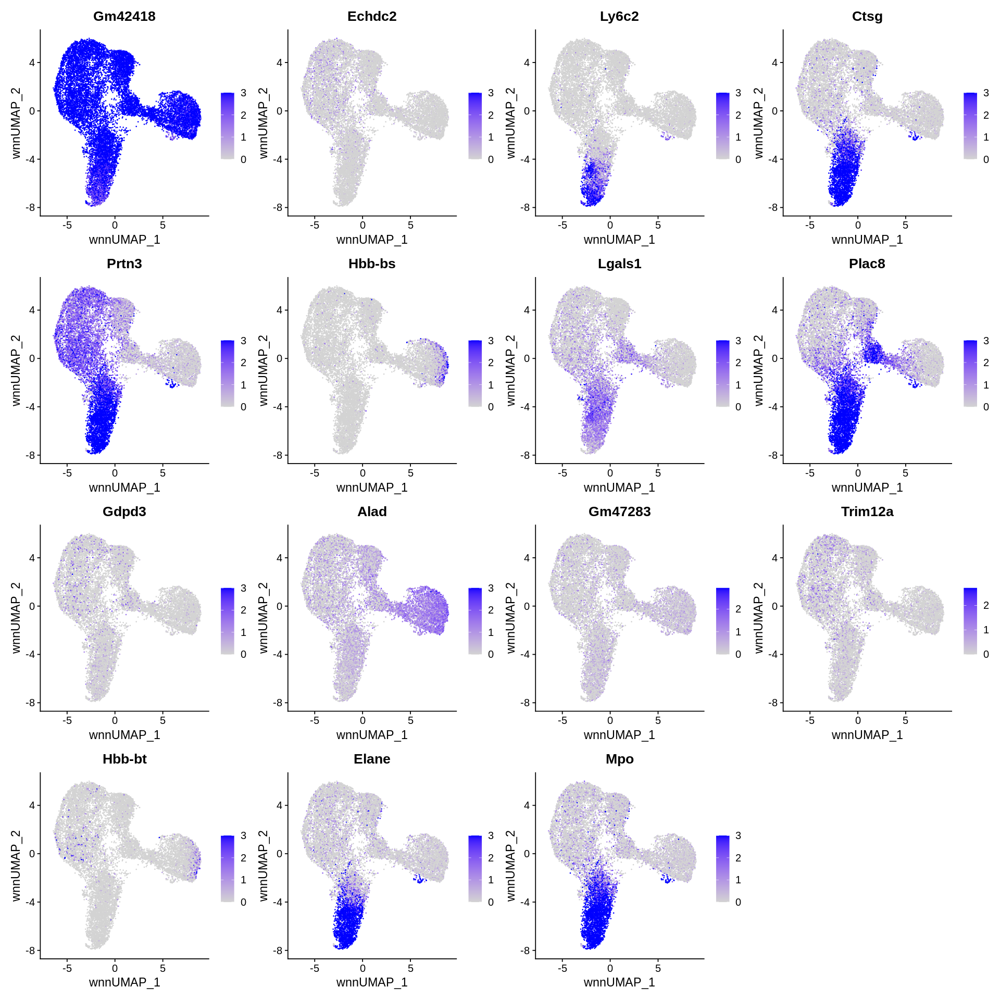

In [458]:
options(repr.plot.width = 16, repr.plot.height = 16)
FeaturePlot(merged_obj, features =deg_list, reduction = 'wnn.umap', max.cutoff=3)


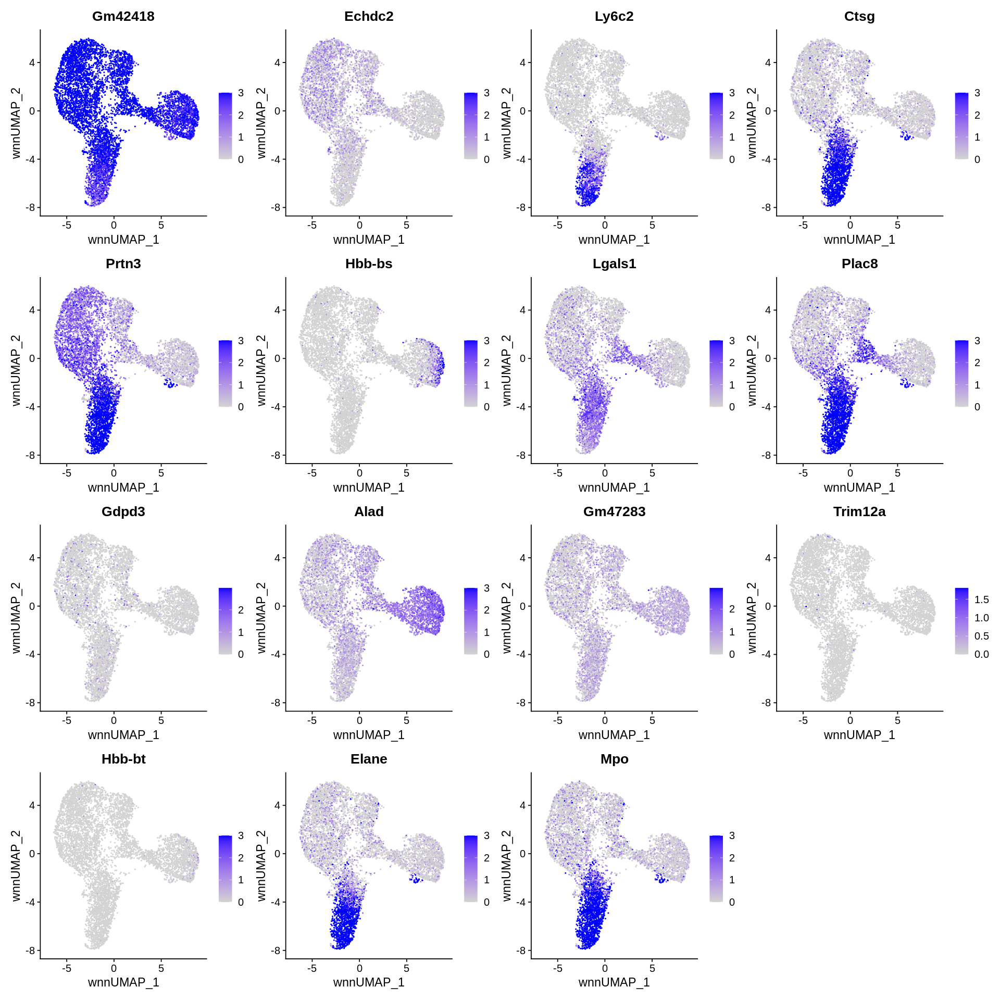

In [460]:
options(repr.plot.width = 16, repr.plot.height = 16)
FeaturePlot(subset(merged_obj,subset = orig.ident=="mWT"), features =deg_list, reduction = 'wnn.umap', max.cutoff=3)


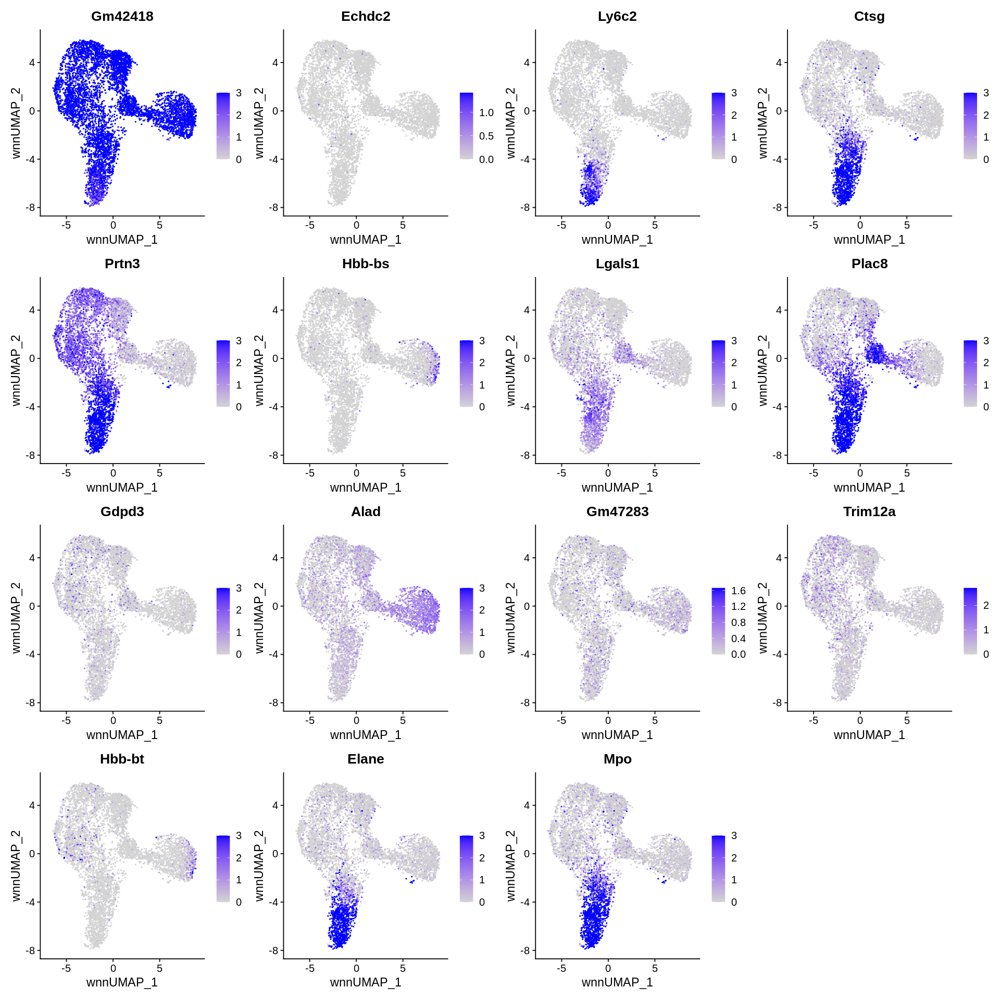

In [461]:
options(repr.plot.width = 16, repr.plot.height = 16)
FeaturePlot(subset(merged_obj,subset = orig.ident=="mNFIXko"), features =deg_list, reduction = 'wnn.umap', max.cutoff=3)


In [462]:
## remove the x-axis text and tick
## plot.margin to adjust the white space between each plot.
## ... pass any arguments to VlnPlot in Seurat
modify_vlnplot<- function(obj, 
                          feature, 
                          pt.size = 0, 
                          plot.margin = unit(c(-0.75, 0, -0.75, 0), "cm"),
                          ...) {
  p<- VlnPlot(obj, features = feature, pt.size = pt.size, ... )  + 
    xlab("") + ylab(feature) + ggtitle("") + 
    theme(legend.position = "none", 
          axis.text.x = element_blank(), 
          axis.ticks.x = element_blank(), 
          axis.title.y = element_text(size = rel(1), angle = 0), 
          axis.text.y = element_text(size = rel(1)), 
          plot.margin = plot.margin ) 
  return(p)
}

## extract the max value of the y axis
extract_max<- function(p){
  ymax<- max(ggplot_build(p)$layout$panel_scales_y[[1]]$range$range)
  return(ceiling(ymax))
}


## main function
StackedVlnPlot<- function(obj, features,
                          pt.size = 0, 
                          plot.margin = unit(c(-0.75, 0, -0.75, 0), "cm"),
                          ...) {
  
  plot_list<- purrr::map(features, function(x) modify_vlnplot(obj = obj,feature = x, ...))
  
  # Add back x-axis title to bottom plot. patchwork is going to support this?
  plot_list[[length(plot_list)]]<- plot_list[[length(plot_list)]] +
    theme(axis.text.x=element_text(), axis.ticks.x = element_line())
  
  # change the y-axis tick to only max value 
  ymaxs<- purrr::map_dbl(plot_list, extract_max)
  plot_list<- purrr::map2(plot_list, ymaxs, function(x,y) x + 
                            scale_y_continuous(breaks = c(y)) + 
                            expand_limits(y = y))

  p<- patchwork::wrap_plots(plotlist = plot_list, ncol = 1)
  return(p)
}

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.

Scale for 'y' is already present. Adding another scale for 'y', 

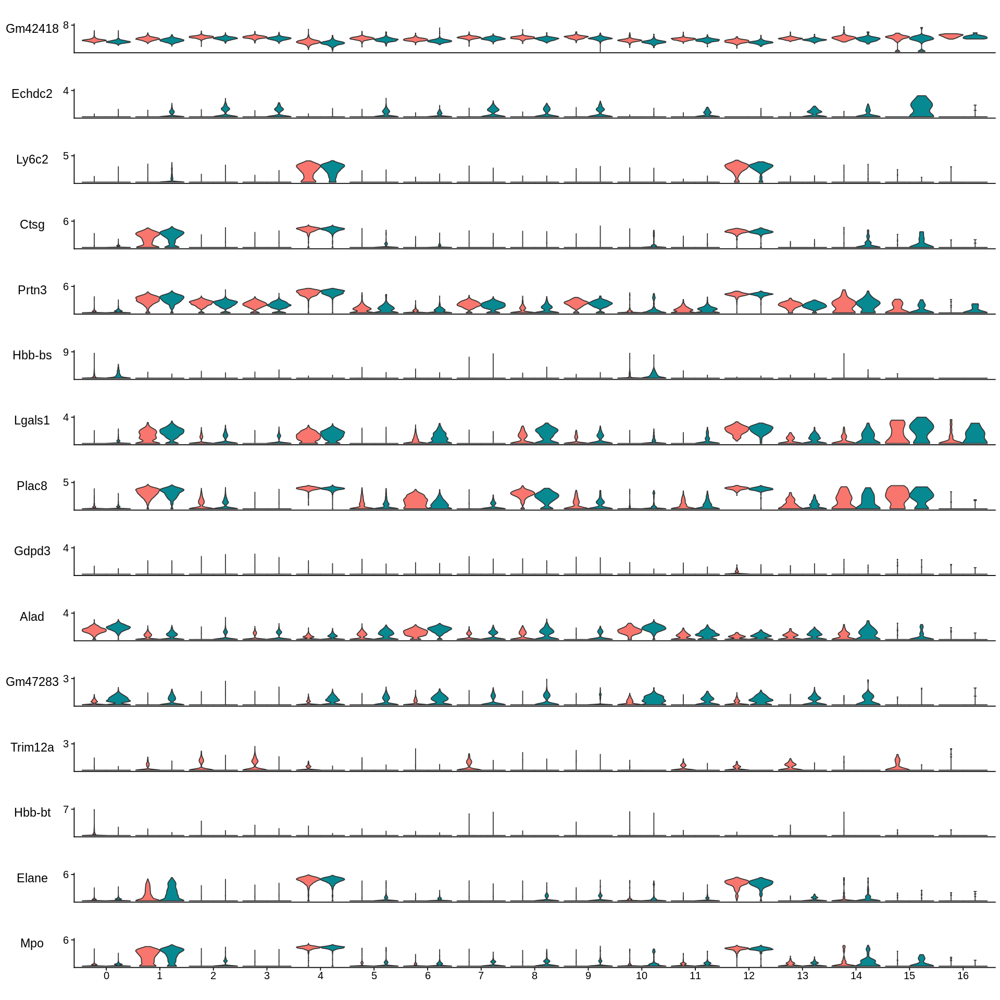

In [466]:
StackedVlnPlot(obj = merged_obj, features = deg_list,split.by="orig.ident")+theme(legend.title = "legend",legend.position = "right")

In [ ]:
StackedVlnPlot(obj = merged_obj, features = deg_list,split.by="orig.ident")

In [467]:
save.image("6_18.RData")

In [470]:
BiocManager::install("dittoSeq")


'getOption("repos")' replaces Bioconductor standard repositories, see
'?repositories' for details

replacement repositories:
    CRAN: https://cran.r-project.org


Bioconductor version 3.12 (BiocManager 1.30.16), R 4.0.5 (2021-03-31)

Installing package(s) 'dittoSeq'

also installing the dependency ‘SingleCellExperiment’


Old packages: 'BiocGenerics', 'cluster', 'devtools', 'diffobj', 'formatR',
  'GenomeInfoDb', 'htmlTable', 'IRkernel', 'Matrix', 'mgcv', 'PCHiCdata',
  'RSQLite', 'rversions', 'testthat', 'viridis', 'zip'



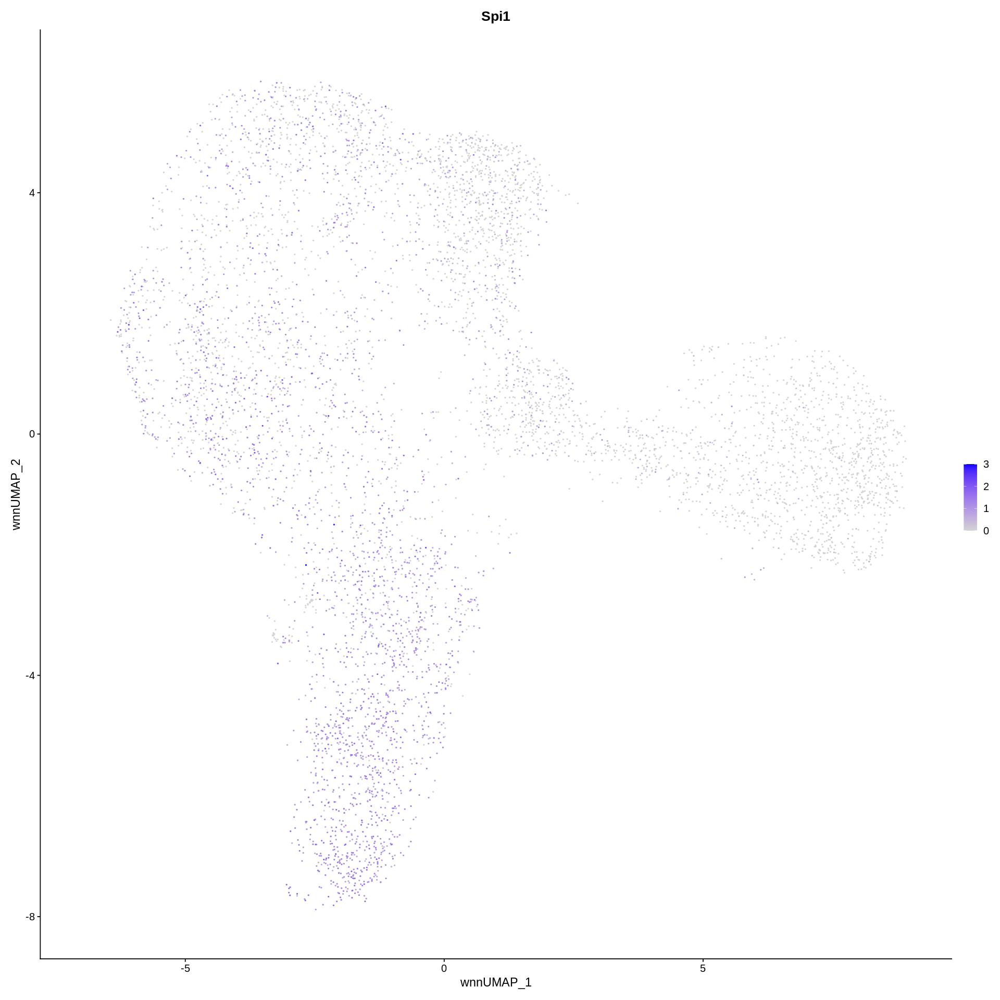

In [468]:
FeaturePlot(subset(merged_obj,subset = orig.ident=="mNFIXko"), features ="Spi1", reduction = 'wnn.umap', max.cutoff=3)


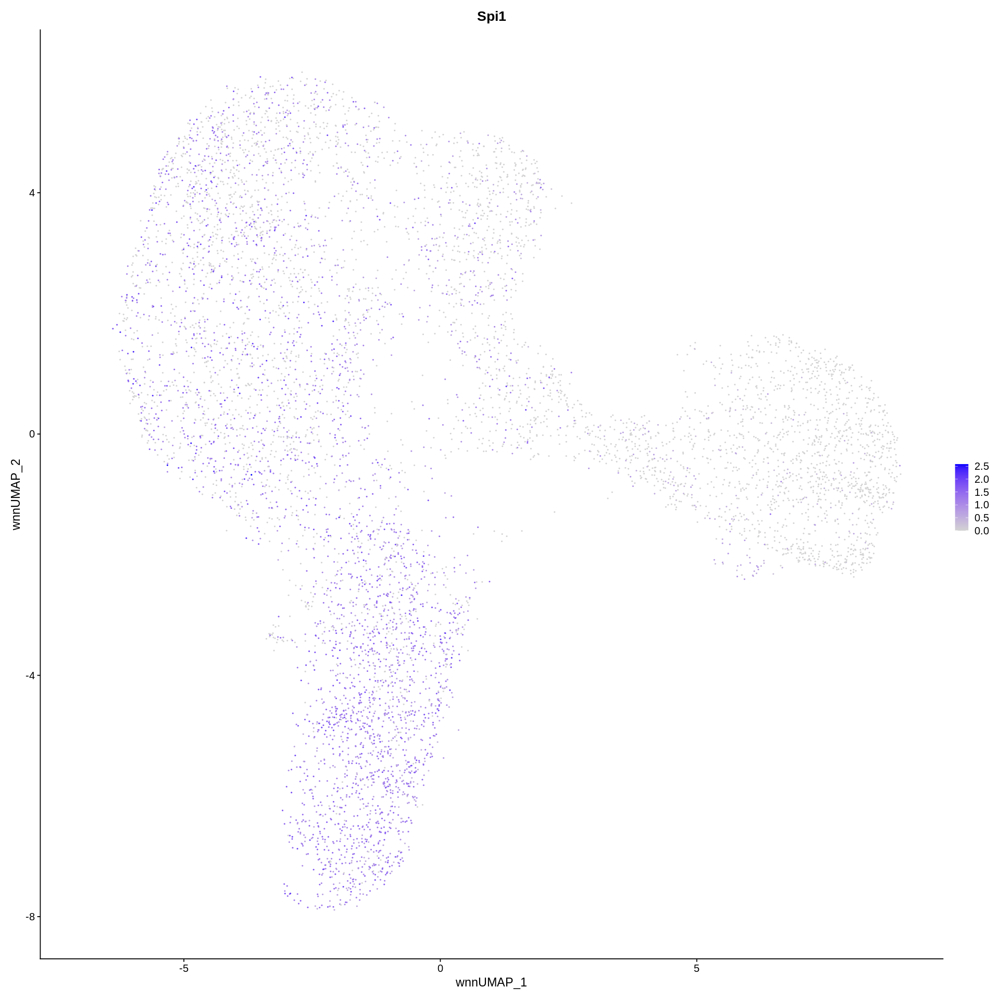

In [469]:
FeaturePlot(subset(merged_obj,subset = orig.ident=="mWT"), features ="Spi1", reduction = 'wnn.umap', max.cutoff=3)
